<a href="https://colab.research.google.com/github/TsabarM/ODSC_hackathon_2020/blob/draft/ODSC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#ODSC 2020 Hackathon

In this notebook I present my analysis and model on the ODSC 2020 Hackathon's data set.
The problem in question: Is it possible to predict the temperature of an electric motor. 
The participants in the hackathon are asked to predict the temperature of 4 parts in an electric motor. 
Overheating can cause severe malfunction. installing physical sensors is not economical. Machine learning model can be accurate and economical.
The participants are askes to predict theese 4 depndent variables:    

*   pm - Permanent Magnet surface temperature (the rotor temperature) – measured with an infrared thermography unit.
*   stator_yoke - Stator yoke temperature – measured by a thermal sensor.
*   stator_tooth - Stator tooth temperature – measured by a thermal sensor.
*   stator_winding - Stator winding temperature – measured by a thermal sensor.








# Setup

In [1]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# import cmath
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_squared_error as rmse
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.cm as cm


# from pandas_profiling import ProfileReport

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [3]:
train = pd.read_csv('/content/drive/My Drive/ODSC/train_set.csv')

In [4]:
def check_missing(df):
  try:
    df.name =[x for x in globals() if globals()[x] is df][0]
    if sum(df.isnull().sum()) == 0:
      print(f"None of the columns in {df.name} have missing data.")
  except:
    print(df.isnull().any())

check_missing(train)
# check_missing(training_set)

None of the columns in train have missing data.


In [5]:
train.dtypes

ambient           float64
coolant           float64
u_d               float64
u_q               float64
motor_speed       float64
torque            float64
i_d               float64
i_q               float64
pm                float64
stator_yoke       float64
stator_tooth      float64
stator_winding    float64
profile_id          int64
dtype: object

In [6]:
list(train.columns)

['ambient',
 'coolant',
 'u_d',
 'u_q',
 'motor_speed',
 'torque',
 'i_d',
 'i_q',
 'pm',
 'stator_yoke',
 'stator_tooth',
 'stator_winding',
 'profile_id']

# Preliminary analysis

# Preprocessing and analysis

In [4]:
# Feature Engineering for Volatge and Current  - Flattening the d and q components with absolute value and calculating the phase angle
def voltage_and_current_feature_engineering(d_component, q_component, df, i_or_u = 'u'):
  ''' 
  Calculates new variables from the d and q components:
  the magnitude, log of the magnitude and the phase angle.
  Re-arrange the columns so that the target variables (temperature variables)
  will the last columns in the dataframe.
  
  Arguments:
    d_component -- {int} -- Voltage / Current d-component
    q_component -- {int} -- Voltage / Current q-component
    df -- {DataFrame} -- the dataframe in which the new features will be stored
    i_or_u -- {str} -- 'u' or 'i' symbols volatge and current accordingly. Default: 'u'.

  Returns:
    The given dataframe with the new features.
  '''
       
  df[i_or_u]=d_component + q_component * 1j
  df[i_or_u + '_abs']=np.abs(df[i_or_u])
  df[i_or_u + '_q_d_ratio'] = q_component / d_component
  df[i_or_u + '_phase_angle'] = np.arctan(df[i_or_u + '_q_d_ratio'])
  df['log_'+ i_or_u + '_abs']=np.log(np.abs(df[i_or_u]))
  df = df[[c for c in df if c not in ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']] 
       + ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']]
  return df

In [5]:
def correlation_heatmap(df, fmt = '.1g', columns_to_exclude = False):
  ''' 
  Creates pearson correlation heatmap.
  
  Arguments:
    df -- {DataFrame} -- the dataframe for the heatmap
    fmt -- {str} -- number of decimal places, for example '.1g' or '.2g'.  Default: '.1g'.
    columns_to_exclude -- {lst} -- string list of the columns to exclude from the heatmap. Default: False.
        
  Returns:
    correlation heatmap.
  '''
  fig, ax = plt.subplots(figsize=(15,15))
  if columns_to_exclude == False:
    matrix = np.triu(df.corr())
    sns.heatmap(df.corr(), annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black', mask=matrix, ax=ax)
  else:
    matrix = np.triu(df.drop(columns_to_exclude, axis=1).corr())
    sns.heatmap((df.drop(columns_to_exclude, axis=1)).corr(), annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black', mask=matrix,  ax=ax)
  

In [6]:
train = voltage_and_current_feature_engineering(train['u_d'], train['u_q'], train, 'u')
train = voltage_and_current_feature_engineering(train['i_d'], train['i_q'], train, 'i')
train.columns

Index(['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
       'i_q', 'profile_id', 'u', 'u_abs', 'u_q_d_ratio', 'u_phase_angle',
       'log_u_abs', 'i', 'i_abs', 'i_q_d_ratio', 'i_phase_angle', 'log_i_abs',
       'pm', 'stator_yoke', 'stator_tooth', 'stator_winding'],
      dtype='object')

In [10]:
train.columns

Index(['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
       'i_q', 'profile_id', 'u', 'u_abs', 'u_q_d_ratio', 'u_phase_angle',
       'log_u_abs', 'i', 'i_abs', 'i_q_d_ratio', 'i_phase_angle', 'log_i_abs',
       'pm', 'stator_yoke', 'stator_tooth', 'stator_winding'],
      dtype='object')

In [13]:
count, bin_edges = np.histogram(np.arange(np.min(train['torque'])-0.5, np.max(train['torque'])+0.5, step=0.1))
bin_edges

array([-3.8459527, -3.1159527, -2.3859527, -1.6559527, -0.9259527,
       -0.1959527,  0.5340473,  1.2640473,  1.9940473,  2.7240473,
        3.4540473])

In [16]:
count, bin_edges = np.histogram((np.min(train['pm']), np.max(train['pm'])),bins=100)
bin_edges


array([-2.628648  , -2.57318696, -2.51772592, -2.46226487, -2.40680383,
       -2.35134279, -2.29588175, -2.24042071, -2.18495966, -2.12949862,
       -2.07403758, -2.01857654, -1.9631155 , -1.90765445, -1.85219341,
       -1.79673237, -1.74127133, -1.68581029, -1.63034924, -1.5748882 ,
       -1.51942716, -1.46396612, -1.40850508, -1.35304403, -1.29758299,
       -1.24212195, -1.18666091, -1.13119987, -1.07573882, -1.02027778,
       -0.96481674, -0.9093557 , -0.85389466, -0.79843361, -0.74297257,
       -0.68751153, -0.63205049, -0.57658945, -0.5211284 , -0.46566736,
       -0.41020632, -0.35474528, -0.29928424, -0.24382319, -0.18836215,
       -0.13290111, -0.07744007, -0.02197903,  0.03348202,  0.08894306,
        0.1444041 ,  0.19986514,  0.25532618,  0.31078723,  0.36624827,
        0.42170931,  0.47717035,  0.53263139,  0.58809244,  0.64355348,
        0.69901452,  0.75447556,  0.8099366 ,  0.86539765,  0.92085869,
        0.97631973,  1.03178077,  1.08724181,  1.14270286,  1.19

/usr/local/lib/python3.6/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


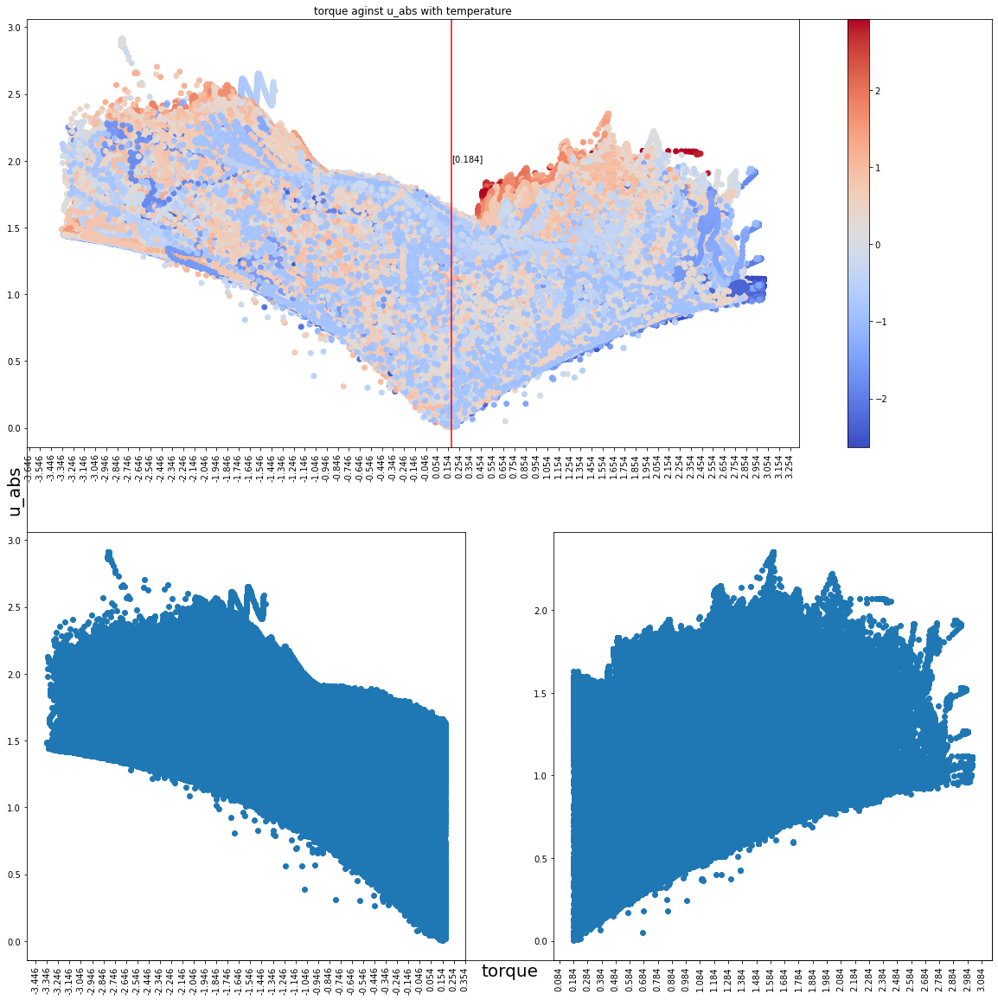

In [12]:
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.cm as cm


fig = plt.figure(figsize=(20,20), frameon = False)
fig.tight_layout(pad=3.0)
plt.ylabel('u_abs', fontsize = 20)
plt.xlabel('torque', fontsize = 20)
plt.xticks(ticks = [], labels=[])
plt.yticks(ticks = [], labels=[])

spec = gridspec.GridSpec(ncols=2, nrows=2, figure=fig)
f_ax1 = fig.add_subplot(spec[0, :])
f_ax2 = fig.add_subplot(spec[1, 0])
f_ax3 = fig.add_subplot(spec[1, 1])

ticks = np.round(np.arange(np.min(train['torque'])-0.5, np.max(train['torque'])+0.5, step=0.1), decimals = 3)
f_ax1.set_xticks(ticks)
f_ax1.set_title('torque aginst u_abs with temperature')
vmin = np.min(np.array(train['pm']))
vmax = np.max(np.array(train['pm']))
im1 = f_ax1.scatter(train['torque'], train['u_abs'], c=train['pm'], cmap=cm.coolwarm, vmin=vmin, vmax=vmax)
f_ax1.set_xticklabels(ticks, rotation=90, ha='center')
plt.colorbar(im1,ax=f_ax1, use_gridspec=True)

cut_point = train['torque'][train['u_abs'] ==np.min(train['u_abs'])].values
f_ax1.axvline(x=cut_point, c='r')
f_ax1.text(cut_point,2,np.round(cut_point, 3))

ticks = np.round(np.arange(np.min(train['torque'][np.array(train['torque'])<cut_point])-0.5, np.max(train['torque'][np.array(train['torque'])<cut_point])+0.5, step=0.1), decimals = 3)
f_ax2.set_xticks(ticks)
f_ax2.scatter(train['torque'][np.array(train['torque'])<cut_point], train['u_abs'][np.array(train['torque'])<cut_point])
f_ax2.set_xticklabels(ticks, rotation=90, ha='center')
fig.show()

ticks = np.round(np.arange(np.min(train['torque'][np.array(train['torque'])>=cut_point])-0.5, np.max(train['torque'][np.array(train['torque'])>=cut_point])+0.5, step=0.1), decimals = 3)
f_ax3.set_xticks(ticks)
f_ax3.scatter(train['torque'][np.array(train['torque'])>=cut_point], train['u_abs'][np.array(train['torque'])>=cut_point])
f_ax3.set_xticklabels(ticks, rotation=90, ha='center')
fig.show()


/usr/local/lib/python3.6/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


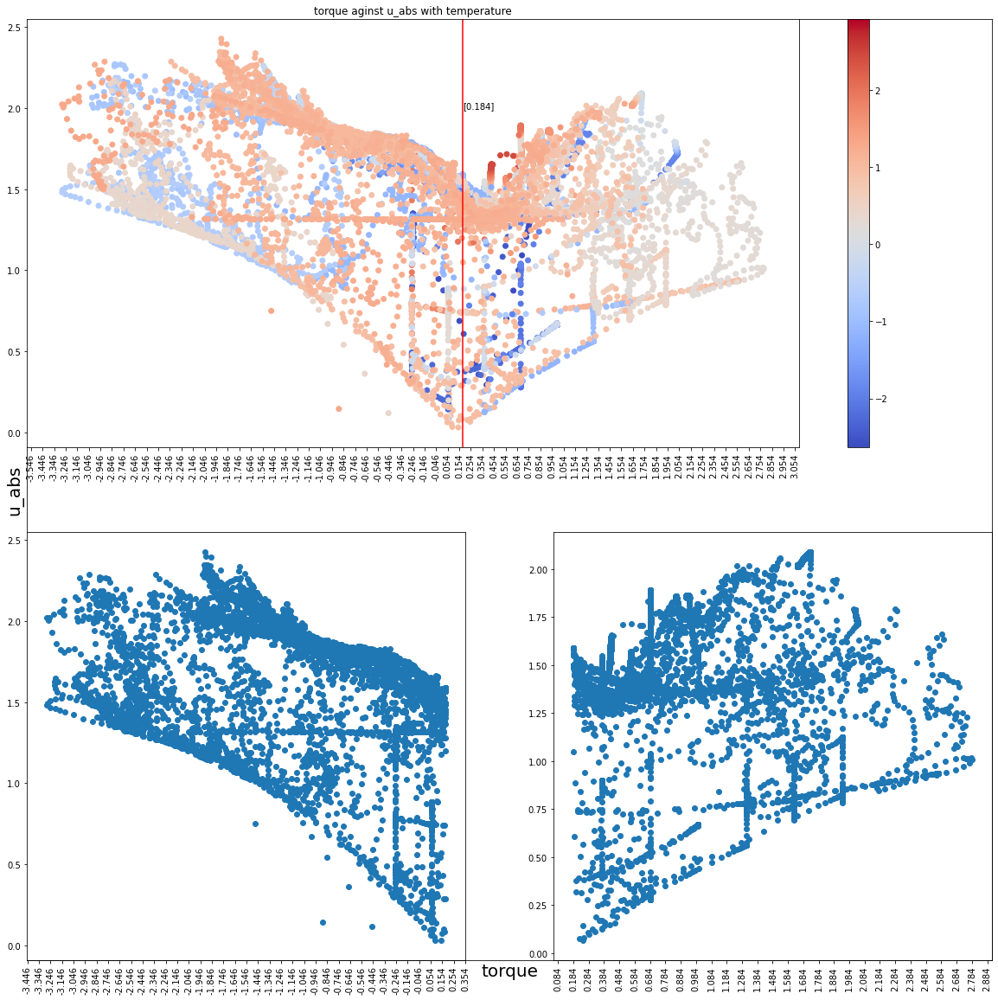

In [14]:
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.cm as cm


fig = plt.figure(figsize=(20,20), frameon = False)
fig.tight_layout(pad=3.0)
plt.ylabel('u_abs', fontsize = 20)
plt.xlabel('torque', fontsize = 20)
plt.xticks(ticks = [], labels=[])
plt.yticks(ticks = [], labels=[])

spec = gridspec.GridSpec(ncols=2, nrows=2, figure=fig)
f_ax1 = fig.add_subplot(spec[0, :])
f_ax2 = fig.add_subplot(spec[1, 0])
f_ax3 = fig.add_subplot(spec[1, 1])

ticks = np.round(np.arange(np.min(train['torque'])-0.5, np.max(train['torque'])+0.5, step=0.1), decimals = 3)
f_ax1.set_xticks(ticks)
f_ax1.set_title('torque aginst u_abs with temperature')
vmin = np.min(np.array(train['pm']))
vmax = np.max(np.array(train['pm']))
im1 = f_ax1.scatter(test['torque'], test['u_abs'], c=test['pm'], cmap=cm.coolwarm, vmin=vmin, vmax=vmax)
f_ax1.set_xticklabels(ticks, rotation=90, ha='center')
plt.colorbar(im1,ax=f_ax1, use_gridspec=True)

cut_point = train['torque'][train['u_abs'] ==np.min(train['u_abs'])].values
f_ax1.axvline(x=cut_point, c='r')
f_ax1.text(cut_point,2,np.round(cut_point, 3))

ticks = np.round(np.arange(np.min(train['torque'][np.array(train['torque'])<cut_point])-0.5, np.max(train['torque'][np.array(train['torque'])<cut_point])+0.5, step=0.1), decimals = 3)
f_ax2.set_xticks(ticks)
f_ax2.scatter(test['torque'][np.array(test['torque'])<cut_point], test['u_abs'][np.array(test['torque'])<cut_point])
f_ax2.set_xticklabels(ticks, rotation=90, ha='center')
fig.show()

ticks = np.round(np.arange(np.min(train['torque'][np.array(train['torque'])>=cut_point])-0.5, np.max(train['torque'][np.array(train['torque'])>=cut_point])+0.5, step=0.1), decimals = 3)
f_ax3.set_xticks(ticks)
f_ax3.scatter(test['torque'][np.array(test['torque'])>=cut_point], test['u_abs'][np.array(test['torque'])>=cut_point])
f_ax3.set_xticklabels(ticks, rotation=90, ha='center')
fig.show()


In [19]:
np.round(np.min(train['motor_speed'].iloc[train['u_abs'].nsmallest(30).index]), 3)


-0.604

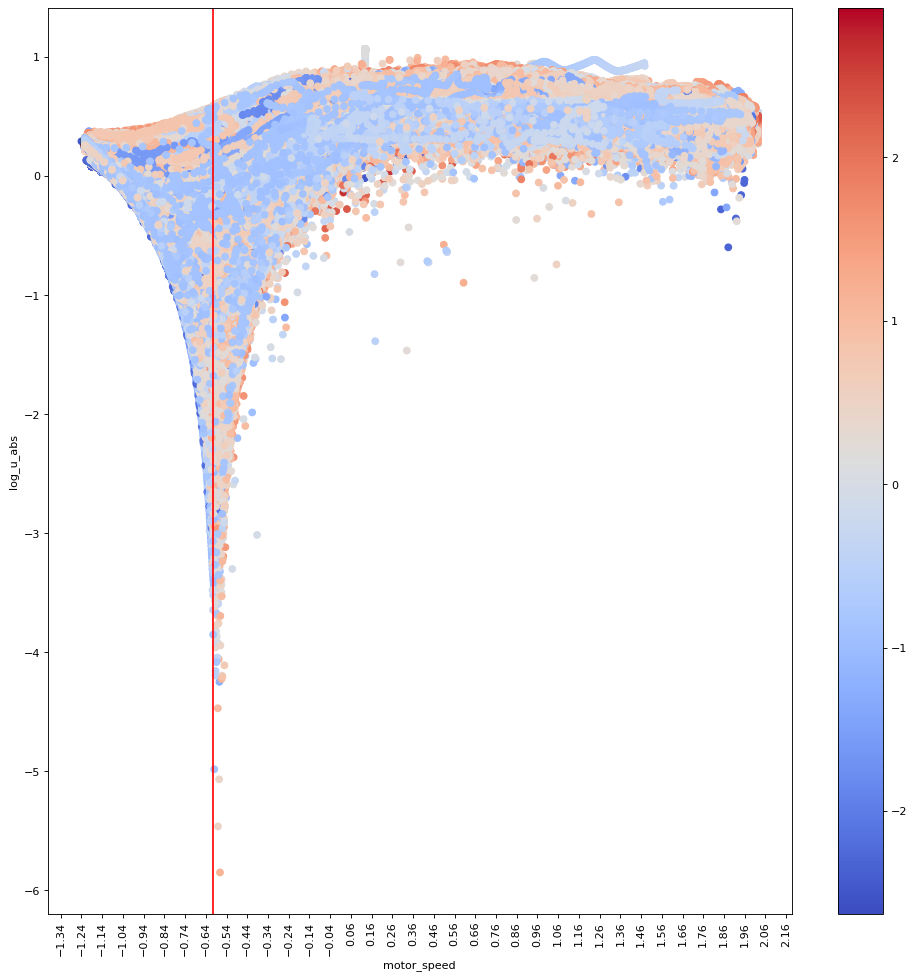

In [70]:
plt.figure(figsize=(15, 15), dpi=80)
plt.xticks(np.arange(np.min(train['motor_speed'])-0.5, np.max(train['motor_speed'])+0.5, step=0.1), rotation=90)
plt.scatter(train['motor_speed'], train['log_u_abs'], c=train['pm'], cmap=cm.coolwarm)
plt.colorbar()
cut_point = np.min(train['motor_speed'].iloc[train['log_u_abs'].nsmallest(30).index])
plt.xlabel('motor_speed')
plt.ylabel('log_u_abs')
plt.axvline(x=cut_point, c='r')

# plt.xticks(np.arange(np.min(train['u_abs'])-0.5, np.max(train['u_abs'])+0.5, step=0.1), rotation=90)
# plt.scatter(train['u_abs'], train['motor_speed'])

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


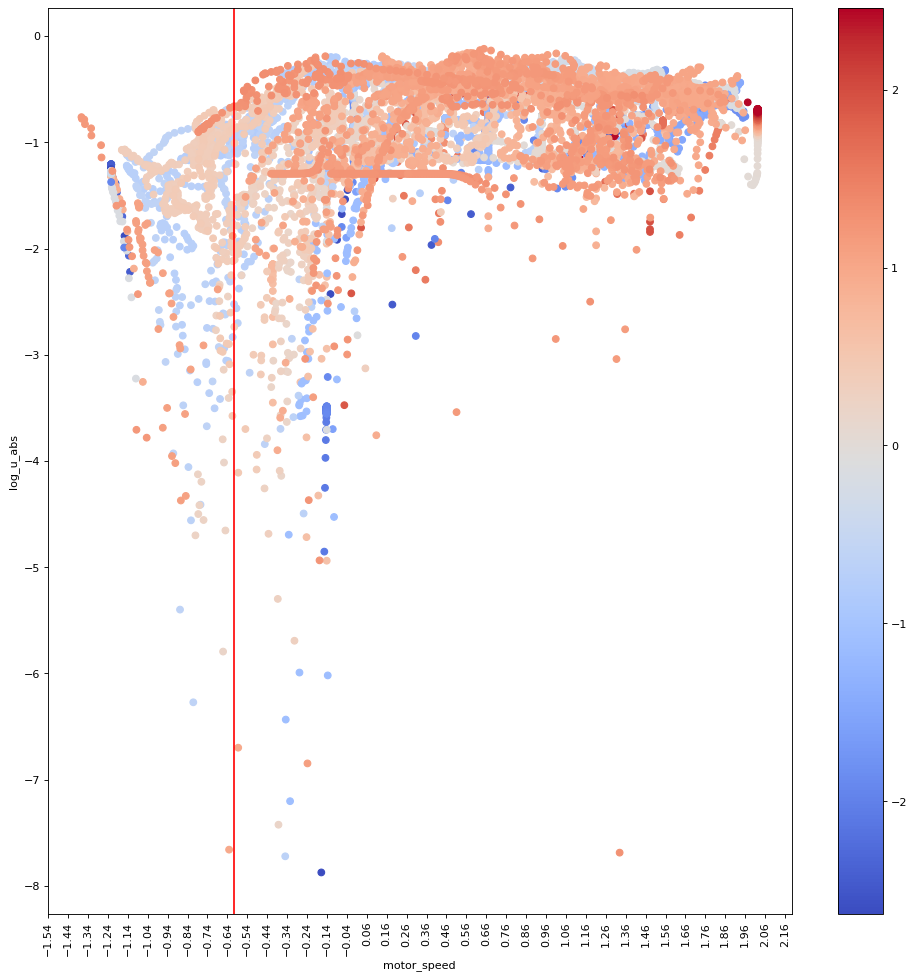

In [16]:
plt.figure(figsize=(15, 15), dpi=80)
plt.xticks(np.arange(np.min(train['motor_speed'])-0.5, np.max(train['motor_speed'])+0.5, step=0.1), rotation=90)
plt.scatter(test['motor_speed'], np.log(test['log_u_abs']), c=test['pm'], cmap=cm.coolwarm)
plt.colorbar()
cut_point = np.min(train['motor_speed'].iloc[train['log_u_abs'].nsmallest(30).index])
plt.xlabel('motor_speed')
plt.ylabel('log_u_abs')
plt.axvline(x=cut_point, c='r')

# plt.xticks(np.arange(np.min(train['u_abs'])-0.5, np.max(train['u_abs'])+0.5, step=0.1), rotation=90)
# plt.scatter(train['u_abs'], train['motor_speed'])

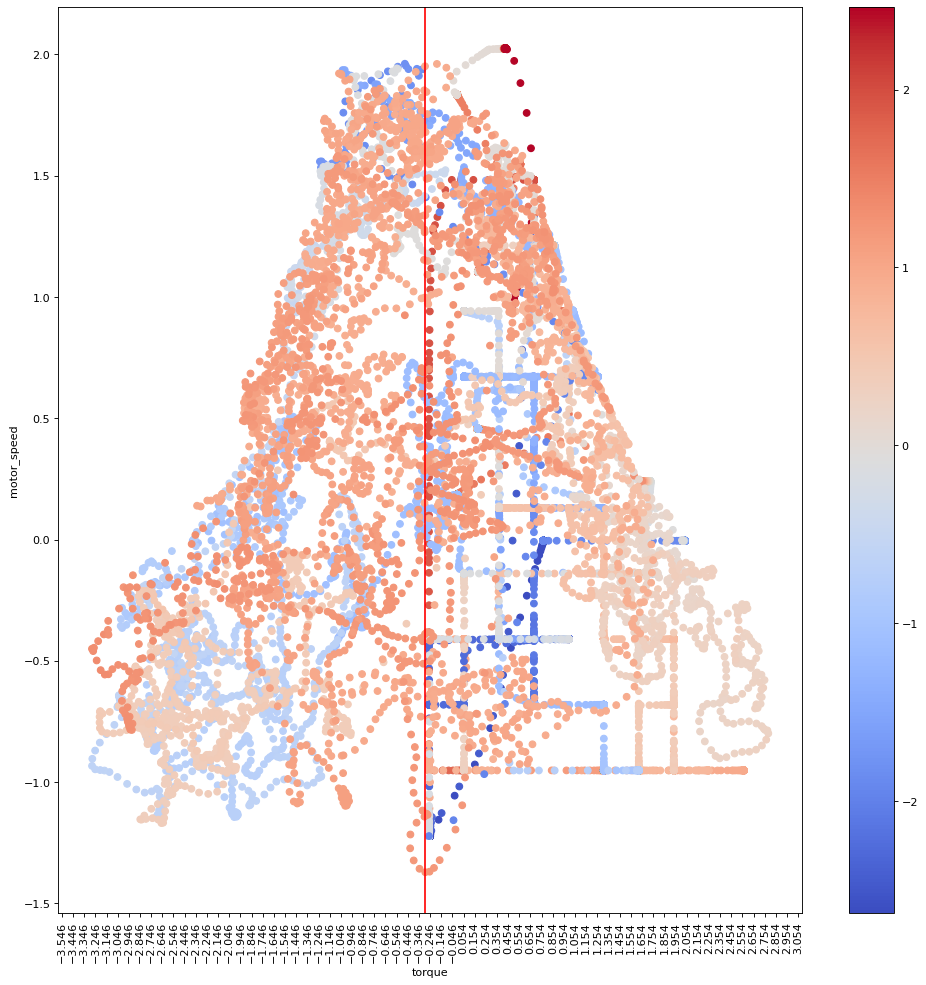

In [69]:
plt.figure(figsize=(15, 15), dpi=80)
plt.xticks(np.arange(np.min(train['torque'])-0.5, np.max(train['torque'])+0.5, step=0.1), rotation=90)
plt.scatter(test['torque'], test['motor_speed'], c=test['pm'], cmap=cm.coolwarm)
plt.colorbar()
cut_point = np.min(train['torque'].iloc[train['motor_speed'].nsmallest(30).index])
plt.xlabel('torque')
plt.ylabel('motor_speed')
plt.axvline(x=cut_point, c='r')


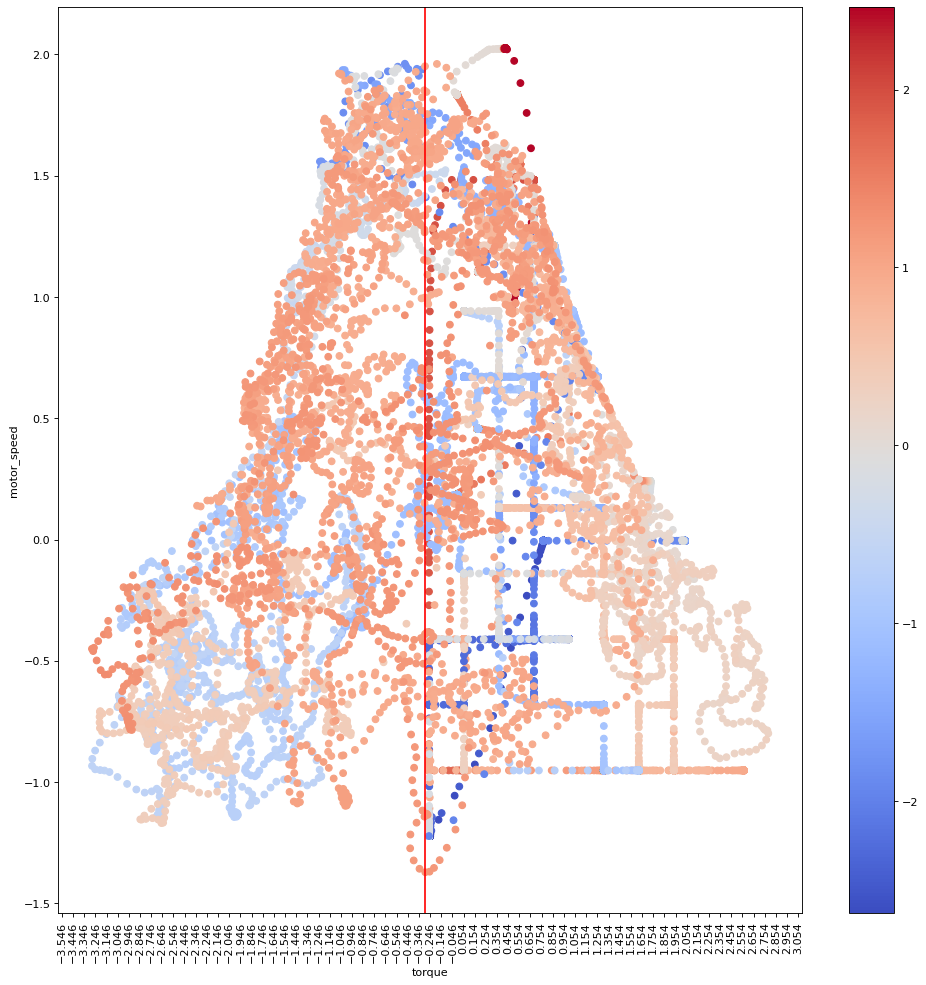

In [30]:
plt.figure(figsize=(15, 15), dpi=80)
plt.xticks(np.arange(np.min(train['torque'])-0.5, np.max(train['torque'])+0.5, step=0.1), rotation=90)
plt.scatter(test['torque'], test['motor_speed'][ test['motor_speed']>-1.2], c=test['pm'], cmap=cm.coolwarm)
plt.colorbar()
cut_point = np.min(train['torque'].iloc[train['motor_speed'].nsmallest(30).index])
plt.xlabel('torque')
plt.ylabel('motor_speed')
plt.axvline(x=cut_point, c='r')

# plt.xticks(np.arange(np.min(train['u_abs'])-0.5, np.max(train['u_abs'])+0.5, step=0.1), rotation=90)
# plt.scatter(train['u_abs'], train['motor_speed'])

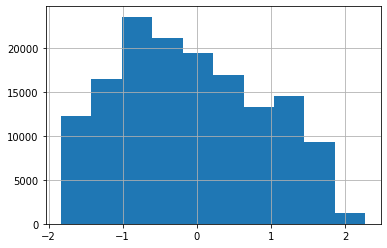

In [380]:

# plot_y(train['motor_speed'][train['motor_speed']<-1.2283],train['motor_speed'][train['motor_speed']<-1.2283])
# plot_y(train['motor_speed'][train['motor_speed']<-1.22193],train['motor_speed'][train['motor_speed']<-1.22193])
train['stator_yoke'][np.round(train['motor_speed'],5)==-1.22243].hist()
# train['motor_speed'][(train['motor_speed']<-1.222) & (train['motor_speed']>-1.2225)].hist()
# np.round(train['motor_speed'][(train['motor_speed']<-1.222) & (train['motor_speed']>-1.2225)], 5).value_counts()


In [37]:
cut_point_torque[0]

0.18393286

In [26]:
cut_point_torque = train['torque'][train['u_abs'] ==np.min(train['u_abs'])].values[0]
cut_point_motor = np.min(train['motor_speed'].iloc[train['log_u_abs'].nsmallest(30).index])

train['cut_point_torque'] = (np.array(train['torque'])<cut_point_torque)
train['cut_point_motor'] = (train['motor_speed'] >= cut_point_motor)
test['cut_point_torque'] = (np.array(test['torque'])<cut_point_torque)
test['cut_point_motor'] = (test['motor_speed'] >= cut_point_motor)

In [15]:
grp = train.groupby(['cut_point_torque', 'cut_point_motor']) 

y_4_columns
grp[y_4_columns].agg([np.sum, np.mean, np.std, np.max, np.min]) 

NameError: ignored

Check for person correlation between the variables inthe dataset

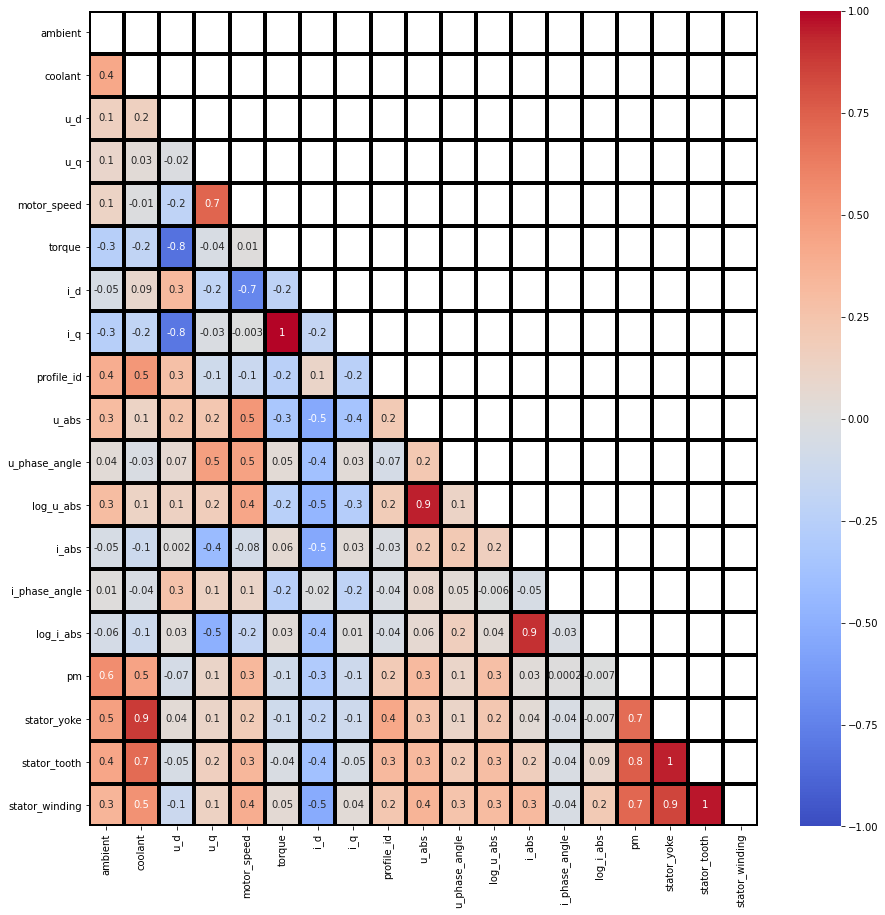

In [ ]:
correlation_heatmap(train, columns_to_exclude = ['u_q_d_ratio', 'i_q_d_ratio', 'u', 'i'])

Conclusions:

1.   There is a strong correlation between the target (depndent) variables: pm, stator_yoke, stator_tooth, stator_winding.
2.   Among the independent variables, the ambient, coolant, motor speed, u_abs, i_abs, and u_phase_angle    
have relativly stronger correlation to the dependent variables (pm, stator_yoke, stator_tooth, stator_winding).
3.   There is a correlation between the profile_id an the depndent variables. This might be taken into account in model as control variables. 
4.   There is a correlation between the following indepndent variables :
*   u_abs and motor speed
*   prfile_id and ambient
*   prfile_id and coolant
*   u_d and torque
*   i_q and torque - **full colinearity**
*   u_q and motor_speed
*   i_d and motor_speed
*   u_d and i_q

Pairplot all pairs of variables in the dataset.

/usr/local/lib/python3.6/dist-packages/pandas/core/dtypes/cast.py:897: ComplexWarning: Casting complex values to real discards the imaginary part
  return arr.astype(dtype, copy=True)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:854: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/usr/local/lib/python3.6/dist-packages/matplotlib/transforms.py:789: ComplexWarning: Casting complex values to real discards the imaginary part
  points = np.array(args, dtype=float).reshape(2, 2)
/usr/local/lib/python3.6/dist-packages/matplotlib/transforms.py:1969: ComplexWarning: Casting complex values to real discards the imaginary part
  x, y = float(x), float(y)
/usr/local/lib/python3.6/dist-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


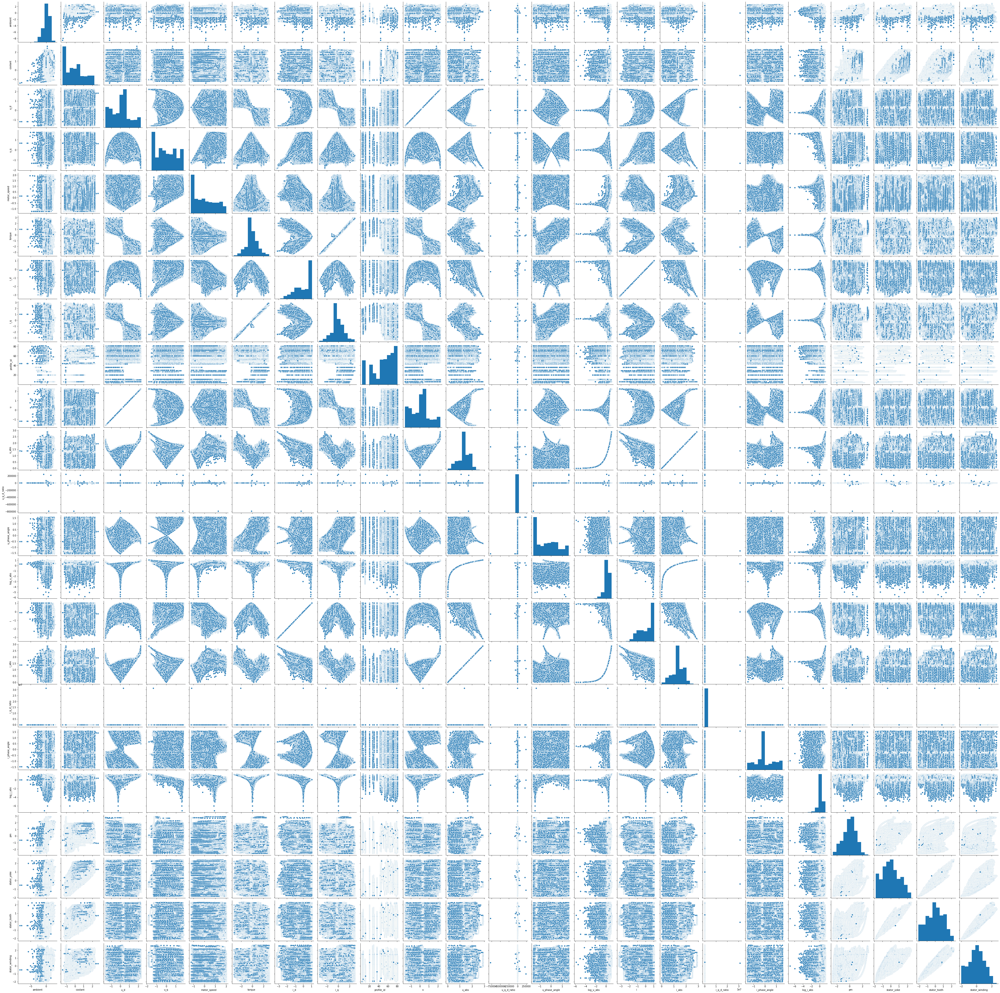

In [ ]:
sns.pairplot(train)

#Graphs to delete

In [172]:
temp = train[(train['coolant']<-1)&(train['motor_speed']<-1.19)]
temp1 = train[train['coolant']<-1]
temp2 = train[train['motor_speed']<-1.19]

In [171]:
temp.describe()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,profile_id,u,u_abs,u_q_d_ratio,u_phase_angle,log_u_abs,i,i_abs,i_q_d_ratio,i_phase_angle,log_i_abs,pm,stator_yoke,stator_tooth,stator_winding
count,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000+0.000000j,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000+0.000000j,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000,22594.000000
mean,-0.440489,-1.087601,0.313333,-1.256386,-1.216283,-0.073808,0.985368,-0.074073,29.307161,0.313333-1.256386j,1.294925,-4.018194,-1.326543,0.257557,0.985368-0.074073j,1.037296,-0.046727,-0.054796,0.035147,-0.426772,-1.418754,-1.499169,-1.442757
std,1.094951,0.039063,0.020691,0.051531,0.011429,0.261679,0.093932,0.306849,20.308407,0.055530+0.000000j,0.054191,0.156715,0.009304,0.042557,0.320904+0.000000j,0.058568,0.385065,0.317163,0.053724,1.239525,0.456328,0.616420,0.646030
min,-3.099254,-1.305783,0.179964,-1.338541,-1.239020,-0.630197,-1.439858,-0.630220,4.000000,0.179964-1.072602j,1.087595,-5.960083,-1.404562,0.083968,-1.439858+2.844843j,0.831985,-19.511787,-1.519590,-0.183941,-2.619518,-1.833012,-2.066143,-2.018513
25%,-1.008887,-1.088026,0.300249,-1.300195,-1.222431,-0.237524,0.930027,-0.245737,20.000000,0.300249-1.291462j,1.270745,-4.129412,-1.333205,0.239604,0.930027+0.247533j,0.962609,-0.238779,-0.234390,-0.038108,-1.347017,-1.746294,-1.880660,-1.846351
50%,-0.078877,-1.078124,0.312409,-1.261308,-1.222430,-0.189691,1.029143,-0.245714,27.000000,0.312409-1.252150j,1.299434,-4.018924,-1.326926,0.261928,1.029143-0.245718j,1.058072,-0.238755,-0.234367,0.056448,-0.659416,-1.617994,-1.787416,-1.746034
75%,0.474108,-1.071357,0.330986,-1.233655,-1.222380,0.126286,1.029160,0.240114,30.000000,0.330986-1.302646j,1.343576,-3.934671,-1.321915,0.295335,1.029160-0.245713j,1.058087,0.257835,0.252339,0.056463,0.616110,-1.235591,-1.279047,-1.225729
max,1.419897,-1.000714,0.392799,-1.072602,-1.190000,2.934786,1.060937,2.844843,79.000000,0.392799-1.243982j,1.376992,-3.166967,-1.264945,0.319901,1.060937-0.258079j,3.188468,10.444355,1.475342,1.159540,2.766711,0.535122,1.619338,2.527180


In [173]:
temp1.describe()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,profile_id,u,u_abs,u_q_d_ratio,u_phase_angle,log_u_abs,i,i_abs,i_q_d_ratio,i_phase_angle,log_i_abs,pm,stator_yoke,stator_tooth,stator_winding
count,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000+0.000000j,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000+0.000000j,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000,234580.000000
mean,-0.849794,-1.069636,-0.307478,-0.060648,0.011128,0.342125,-0.060604,0.339042,22.459029,-0.307478-0.060648j,1.184755,0.211028,-0.293645,0.059864,-0.060604+0.339042j,1.349670,1.017234,0.014556,0.212853,-0.516997,-0.962556,-0.774008,-0.575886
std,1.098270,0.027506,0.872360,0.881195,1.036096,0.893034,1.141229,0.879042,15.923522,1.239966+0.000000j,0.481754,499.389286,0.918263,0.515174,1.440527+0.000000j,0.610020,25.297008,0.691232,0.412361,1.190475,0.599500,0.926625,1.123282
min,-8.573954,-1.429349,-1.655373,-1.861463,-1.239020,-3.339106,-3.245874,-3.329749,4.000000,-1.655373-1.214851j,0.014290,-4012.974933,-1.570547,-4.248200,-3.245874-2.389300j,0.014765,-1416.083482,-1.570090,-4.215529,-2.628648,-1.834688,-2.066143,-2.019973
25%,-1.551127,-1.079404,-1.078788,-0.783818,-0.897771,-0.221313,-1.073516,-0.245711,6.000000,-1.078788+0.865254j,0.828761,-2.420986,-1.179087,-0.187824,-1.073516+0.305165j,1.018080,-0.292971,-0.284995,0.017919,-1.495201,-1.483563,-1.601594,-1.611195
50%,-0.829438,-1.069635,-0.094680,-0.146913,-0.161889,0.325192,0.386201,0.304048,27.000000,-0.094680-0.563454j,1.287778,-0.523864,-0.482556,0.252918,0.386201+1.136771j,1.090915,-0.205086,-0.202281,0.087017,-0.674596,-1.024358,-0.900211,-0.759675
75%,0.022948,-1.055539,0.297710,0.722025,0.941928,0.771413,1.013966,0.689020,30.000000,0.297710+0.392771j,1.495214,0.400434,0.380881,0.402269,1.013966-0.091446j,1.561716,0.490619,0.456115,0.445785,0.281066,-0.564082,-0.187158,0.126524
max,2.662891,-1.000017,2.274734,1.785646,2.024164,3.014827,1.060937,2.914185,79.000000,2.274734-1.173060j,2.912992,241462.477051,1.570792,1.069181,1.060937-0.258079j,4.030440,7452.140005,1.570662,1.393876,2.917456,0.612942,1.682430,2.653781


In [174]:
temp2.describe()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,profile_id,u,u_abs,u_q_d_ratio,u_phase_angle,log_u_abs,i,i_abs,i_q_d_ratio,i_phase_angle,log_i_abs,pm,stator_yoke,stator_tooth,stator_winding
count,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000+0.000000j,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000+0.000000j,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000,163723.000000
mean,0.225770,0.272419,0.326608,-1.288915,-1.221380,-0.230206,1.021894,-0.221698,64.567110,0.326608-1.288915j,1.329824,-3.962913,-1.322605,0.284705,1.021894-0.221698j,1.056046,-0.211982,-0.209571,0.053982,-0.135481,-0.130038,-0.408243,-0.578482
std,0.685651,0.994501,0.021924,0.033874,0.005074,0.130920,0.056954,0.143033,17.937047,0.040350+0.000000j,0.034243,0.265861,0.016062,0.026318,0.153955+0.000000j,0.043425,0.209869,0.137868,0.030461,0.802822,1.003489,0.932257,0.806689
min,-4.731746,-1.305783,0.179964,-1.426560,-1.239020,-3.130326,-1.439858,-3.136971,4.000000,0.179964-1.072602j,1.087595,-5.960083,-1.404562,0.083968,-1.439858+2.844843j,0.779531,-19.511787,-1.519590,-0.249063,-2.622748,-1.833012,-2.066143,-2.018513
25%,-0.123267,-0.611955,0.303830,-1.316153,-1.222431,-0.255640,1.029138,-0.245726,65.000000,0.303830-1.276717j,1.311751,-4.219534,-1.338097,0.271363,1.029138-0.245748j,1.058066,-0.238769,-0.234380,0.056443,-0.735408,-0.931717,-1.140901,-1.225829
50%,0.418876,0.176027,0.325806,-1.297194,-1.222430,-0.255640,1.029144,-0.245716,69.000000,0.325806-1.303388j,1.333163,-3.956227,-1.323216,0.287555,1.029144-0.245700j,1.058072,-0.238758,-0.234370,0.056448,-0.094418,-0.205828,-0.501734,-0.666002
75%,0.675642,1.002127,0.347285,-1.265528,-1.222429,-0.255640,1.029153,-0.245708,76.000000,0.347285-1.299032j,1.359636,-3.692764,-1.306339,0.307217,1.029153-0.245713j,1.058079,-0.238748,-0.234361,0.056455,0.385574,0.689039,0.339283,0.018017
max,1.556659,2.294652,0.392799,-1.072602,-1.190000,2.934786,1.060937,2.844843,81.000000,0.392799-1.243982j,1.456165,-3.166967,-1.264945,0.375806,1.060937-0.258079j,3.315407,14.055524,1.499770,1.198580,2.766711,2.277643,2.264545,2.527180


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7466: ComplexWarning: Casting complex values to real discards the imaginary part
  correl = libalgos.nancorr(ensure_float64(mat), minp=min_periods)


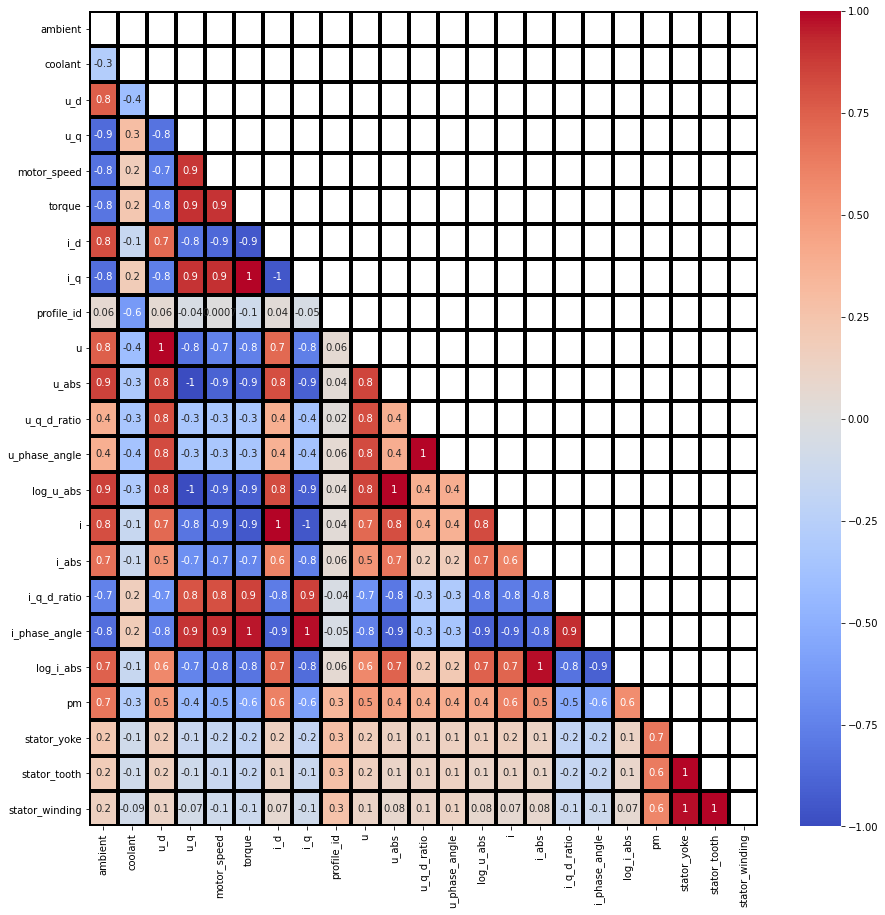

In [176]:
correlation_heatmap(temp)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7466: ComplexWarning: Casting complex values to real discards the imaginary part
  correl = libalgos.nancorr(ensure_float64(mat), minp=min_periods)


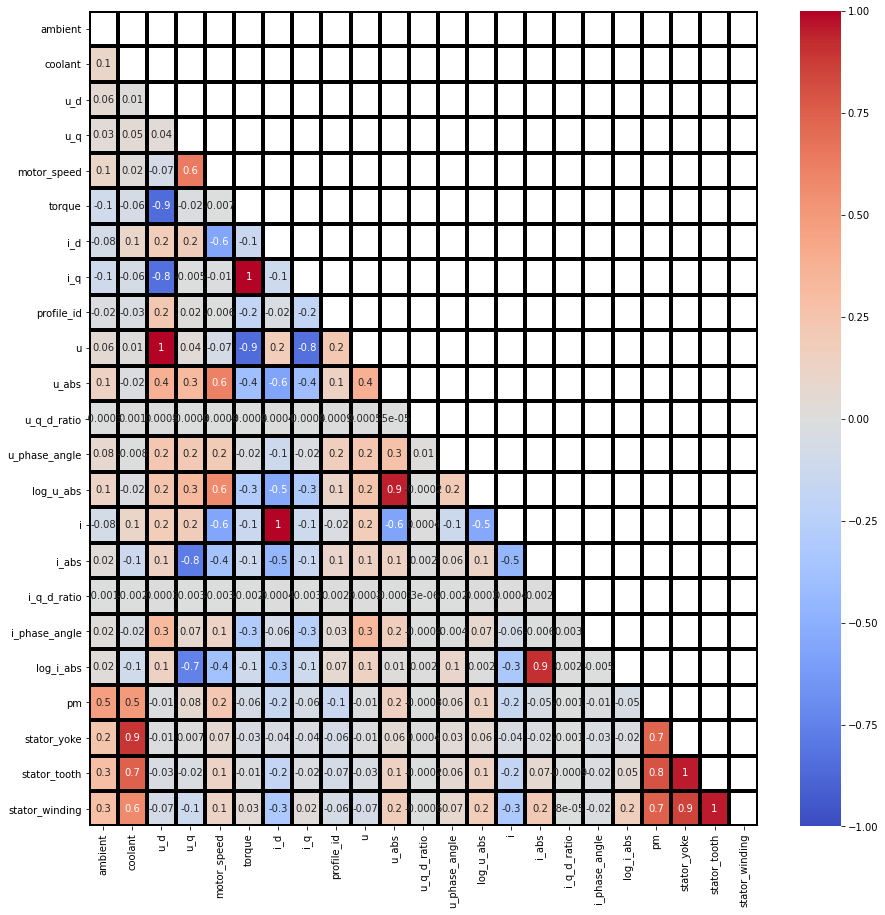

In [178]:
temp = train[(train['coolant']>-1)&(train['motor_speed']>-1.19)]
correlation_heatmap(temp)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7466: ComplexWarning: Casting complex values to real discards the imaginary part
  correl = libalgos.nancorr(ensure_float64(mat), minp=min_periods)


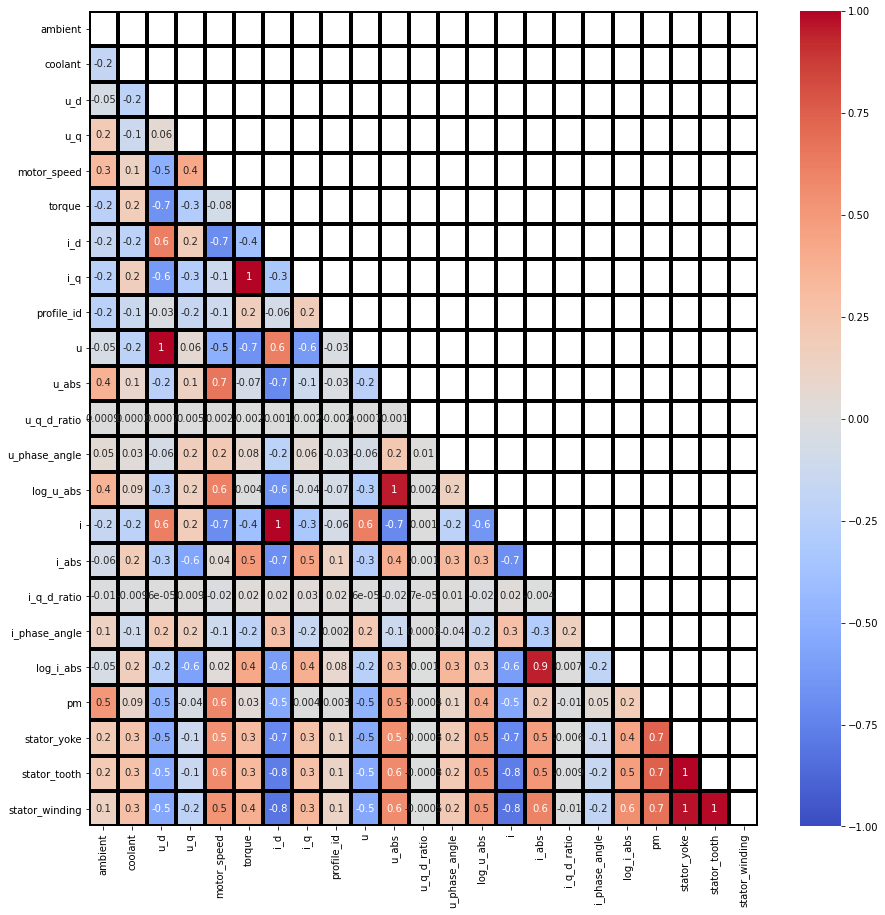

In [179]:
temp = train[(train['coolant']<=-1)&(train['motor_speed']>-1.19)]
correlation_heatmap(temp)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7466: ComplexWarning: Casting complex values to real discards the imaginary part
  correl = libalgos.nancorr(ensure_float64(mat), minp=min_periods)


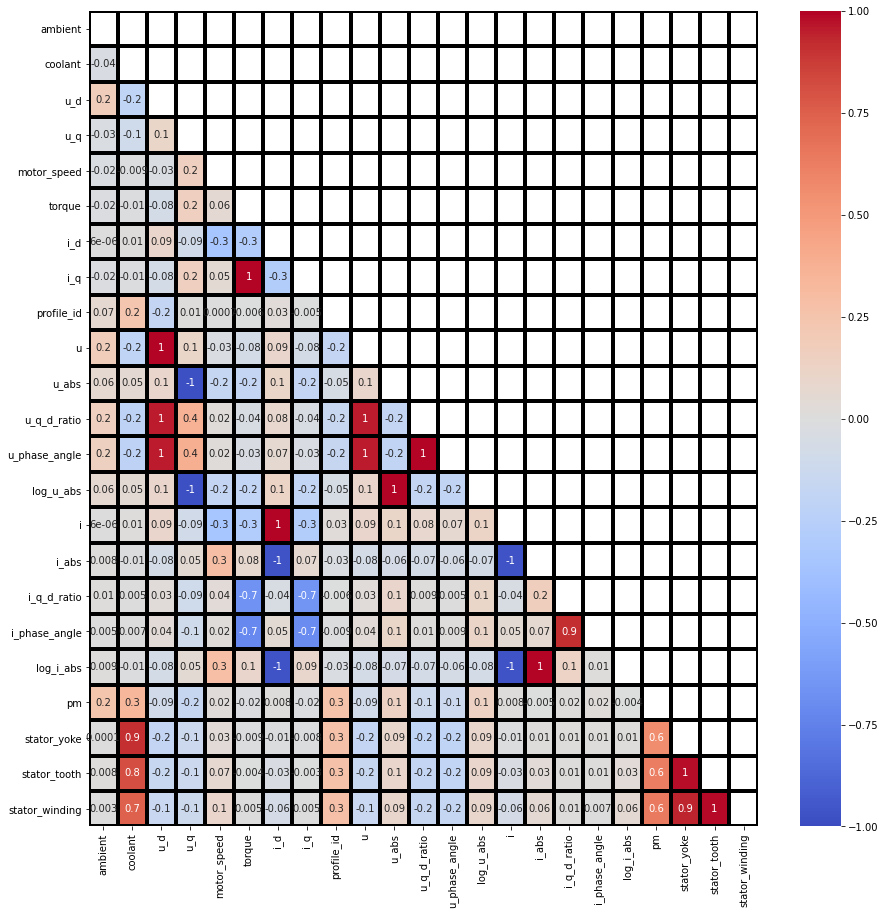

In [180]:
temp = train[(train['coolant']>-1)&(train['motor_speed']<=-1.19)]
correlation_heatmap(temp)

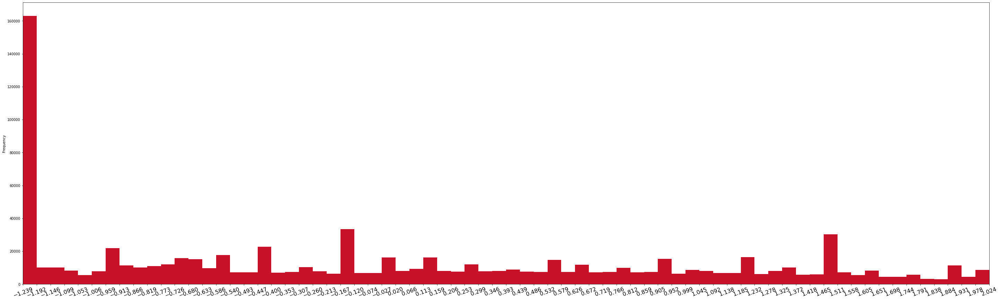

In [168]:
plot_y(train['motor_speed'],train['motor_speed'], bins=70)

In [84]:
(train['ambient']/train['coolant']).describe(percentiles = [0.1,0.2,0.8,0.9])

count    846368.000000
mean          0.274907
std          26.396567
min       -4475.816510
10%          -1.385529
20%          -0.663782
50%           0.343689
80%           1.541178
90%           2.573673
max       11100.640651
dtype: float64

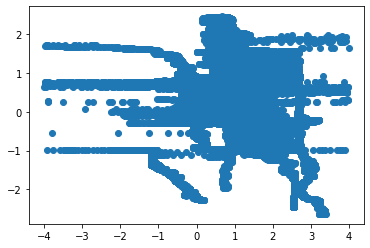

In [98]:
condition = (np.abs(test['ambient'])/np.abs(test['coolant'])<4)
temp = test[condition]
temp.head()
plt.scatter(temp['ambient']/temp['coolant'],temp['pm'])
# (np.abs(temp['ambient'])/np.abs(temp['coolant'])).hist()

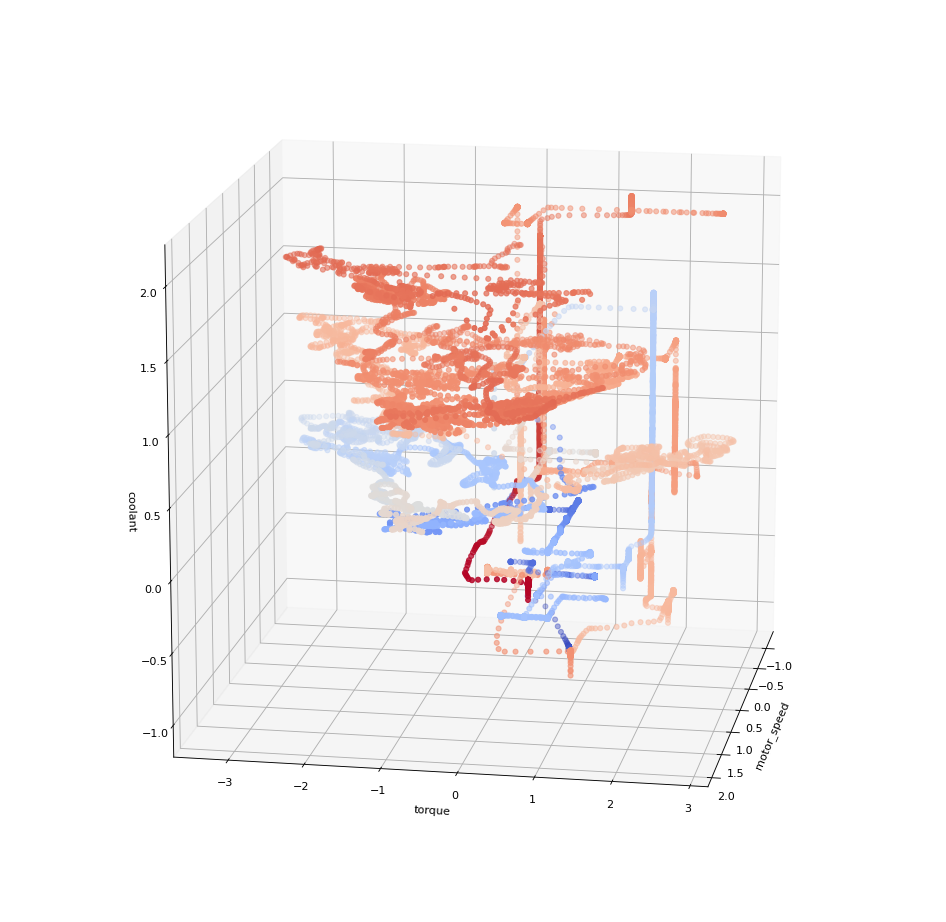

In [24]:

from mpl_toolkits import mplot3d
fig = plt.figure(figsize=(15, 15), dpi=80)
ax = plt.axes(projection='3d')
# Data for a three-dimensional line
# zline = test['coolant']
# xline = test['stator_yoke']
# yline = test['stator_winding']
# ax.plot3D(xline, yline, zline, 'gray')

# Data for three-dimensional scattered points
zdata = test['coolant'][(test['coolant']>-1)&(test['motor_speed']>-1.2)]
xdata = test['motor_speed'][(test['coolant']>-1)&(test['motor_speed']>-1.2)]
y_ratio = test['motor_speed']/test['coolant']
ydata = test['torque'][(test['coolant']>-1)&(test['motor_speed']>-1.2)]
ax.scatter3D(xdata, ydata, zdata, c=test['pm'][(test['coolant']>-1)&(test['motor_speed']>-1.2)], cmap=cm.coolwarm);
ax.set_xlabel('motor_speed')
ax.set_ylabel('torque')
ax.set_zlabel('coolant');
ax.view_init(15,10)

plt.show()

# plt.figure(figsize=(15, 15), dpi=80)

# plt.scatter(test['stator_yoke'],test['stator_winding'], c=test['pm'], cmap=cm.coolwarm)
# plt.colorbar()

In [10]:
from mpl_toolkits import mplot3d
fig = plt.figure(figsize=(15, 15), dpi=80)
ax = plt.axes(projection='3d')
# Data for a three-dimensional line
# zline = test['coolant']
# xline = test['stator_yoke']
# yline = test['stator_winding']
# ax.plot3D(xline, yline, zline, 'gray')

# Data for three-dimensional scattered points
zdata = train['coolant'][(train['coolant']<-1)&(train['motor_speed']<-1.2)]
xdata = train['motor_speed'][(train['coolant']<-1)&(train['motor_speed']<-1.2)]
y_ratio = train['motor_speed']/train['coolant']
ydata = train['ambient'][(train['coolant']<-1)&(train['motor_speed']<-1.2)]
ax.scatter3D(xdata, ydata, zdata, c=train['pm'][(train['coolant']<-1)&(train['motor_speed']<-1.2)], cmap=cm.coolwarm);
ax.set_xlabel('motor_speed')
ax.set_ylabel('ambient')
ax.set_zlabel('coolant');
ax.view_init(50,170)

plt.show()

# plt.figure(figsize=(15, 15), dpi=80)

# plt.scatter(test['stator_yoke'],test['stator_winding'], c=test['pm'], cmap=cm.coolwarm)
# plt.colorbar()

<IPython.core.display.Javascript object>

In [36]:
X_columns = ['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs', 'u_phase_angle', 'log_i_abs', 'i_phase_angle']
y_4_columns= ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']

X_train = train[X_columns]
y_4_train = train[y_4_columns]
X_test = test[X_columns]
y_4_test = test[y_4_columns]

y_4_train.describe()

,pm,stator_yoke,stator_tooth,stator_winding
count,846368.000000,846368.000000,846368.000000,846368.000000
mean,-0.000441,0.012695,0.000753,-0.008259
std,0.991628,1.015148,1.006694,0.997647
min,-2.628648,-1.834688,-2.066143,-2.019973
25%,-0.656185,-0.736750,-0.761951,-0.723910
50%,0.083156,-0.052310,0.012339,0.009469
75%,0.684179,0.728644,0.778085,0.707115
max,2.917456,2.449158,2.302169,2.653781


In [37]:
np.quantile(train['pm'],0.25)

-0.6561853975

In [42]:
from sklearn.decomposition import PCA

X_train_edge= train[X_columns][(train['pm']>=np.quantile(train['pm'],0.75)) | (train['pm']<=np.quantile(train['pm'],0.25))]
X_train_iqr = train[X_columns][(train['pm']<np.quantile(train['pm'],0.75)) & (train['pm']>np.quantile(train['pm'],0.25))]
y_train_edge = train['pm'][(train['pm']>=np.quantile(train['pm'],0.75)) | (train['pm']<=np.quantile(train['pm'],0.25))]
y_train_iqr = train['pm'][(train['pm']<np.quantile(train['pm'],0.75)) & (train['pm']>np.quantile(train['pm'],0.25))]

pca = PCA(n_components=3)
principalComponents = pca.fit_transform(X_train)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc_1', 'pc_2', 'pc_3'])
print(pca.components_, sum(pca.explained_variance_ratio_))
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(X_train_edge)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc_1', 'pc_2', 'pc_3'])
print(pca.components_, sum(pca.explained_variance_ratio_))
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(X_train_iqr)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc_1', 'pc_2', 'pc_3'])
print(pca.components_, sum(pca.explained_variance_ratio_))
# principalComponents_test = pca.fit_transform(X_test)
# principalDf_test = pd.DataFrame(data = principalComponents_test
#              , columns = ['pc_1', 'pc_2', 'pc_3'])
# # finalDf = pd.concat([principalDf, train[['pm']]], axis = 1)
# print(pca.components_, sum(pca.explained_variance_ratio_))

[[-6.01629893e-01 -5.69094657e-01 -2.41766017e-01  4.54722507e-01
  -1.52549155e-01 -1.12742767e-01  5.50233187e-02 -9.96977251e-02]
 [-6.48333575e-02 -2.47011779e-01  7.25231009e-01  1.90035901e-01
   1.08589340e-01  5.96645235e-01  3.09925164e-03  7.01524793e-02]
 [-2.07813674e-01 -4.44897674e-01  1.51407624e-04 -7.27335328e-01
   3.44737370e-02 -3.76717217e-02  1.92076624e-02  4.76325837e-01]] 0.669272178448383
[[-0.6812292  -0.5485517  -0.29946927  0.32434076 -0.15659692 -0.10381413
   0.05347385 -0.04449295]
 [ 0.12366995  0.08738327 -0.66611131 -0.42410893 -0.08131935 -0.58625897
  -0.01790282  0.0535192 ]
 [ 0.16259567  0.39087924 -0.15777535  0.69522782 -0.0298003  -0.27032487
  -0.03662565 -0.48706904]] 0.7072716701373336
[[-0.0518089  -0.4033464   0.71343424  0.03748111  0.12208172  0.53566739
  -0.01468264  0.14891339]
 [ 0.12322851  0.30393246  0.09805448 -0.85311491  0.13273494  0.03664712
  -0.02306032  0.36813952]
 [ 0.19715434  0.77509049  0.14378673  0.22871228  0.0103

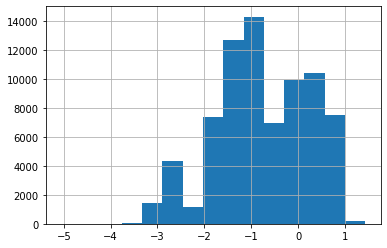

In [138]:
test['ambient'].hist(bins=15)

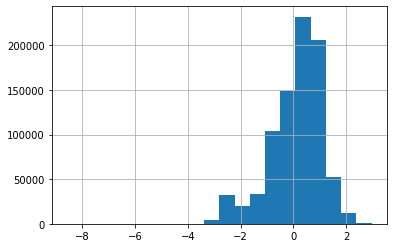

In [137]:
train['ambient'].hist(bins=20)

#Model

##Baseline model

### Loading & Preprocessing Test Data

In [11]:
test = pd.read_csv('/content/drive/My Drive/ODSC/test_set.csv')
test_solutions = pd.read_csv('/content/drive/My Drive/ODSC/test_solutions.csv')
test = pd.merge(test, test_solutions, left_index=True, right_index=True)

In [12]:
test = voltage_and_current_feature_engineering(test['u_d'], test['u_q'], test, 'u')
test = voltage_and_current_feature_engineering(test['i_d'], test['i_q'], test, 'i')

In [16]:
test.columns

Index(['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
       'i_q', 'u', 'u_abs', 'u_q_d_ratio', 'u_phase_angle', 'log_u_abs', 'i',
       'i_abs', 'i_q_d_ratio', 'i_phase_angle', 'log_i_abs', 'pm',
       'stator_yoke', 'stator_tooth', 'stator_winding'],
      dtype='object')

###Functions for prediction and plotting the results

In [25]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_squared_error as rmse

# X = train[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque']]
# y = train['pm']
# X_test = test[X.columns]
# y_test = test['pm']
# bins = np.linspace(np.min(y), np.max(y), 10) 
# y_binned = np.digitize(y, bins)

# skf = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)
# skf.get_n_splits(X, y_binned)
# print(skf)


def train_and_predict(X, y, X_test, y_test, model = False, exp = False, CV_5_stratified = False):
  
  if exp:
    y = np.exp(y)
    y_test = np.exp(y_test)
  bins = np.linspace(np.min(y), np.max(y), 10) 
  y_binned = np.digitize(y, bins)
  skf = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)
  skf.get_n_splits(X, y_binned)
  
  if not model:
    model = LinearRegression()
 
  if CV_5_stratified:
    for train_index, test_index in skf.split(X, y_binned):
      X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
      y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
      model.fit(X_train, y_train)
      coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])  
      print(coeff_df)
      
      y_train_predict = model.predict(X_train)
      y_valid_predict = model.predict(X_valid)
      y_test_predict = model.predict(X_test)
      
      if exp:
        for prediction in (y_train_predict, y_valid_predict, y_test_predict):
          low_values_flags = prediction <= 0  # Where values are low
          prediction[low_values_flags] = 0.01  # All low values set to 0

      
        print(f' RMSE training set: {rmse(np.log(y_train_predict), np.log(y_train), squared = False)}\
              \n RMSE validation set: {rmse(np.log(y_valid_predict), np.log(y_valid), squared = False)}\
              \n RMSE test set: {rmse(np.log(y_test_predict), np.log(y_test), squared = False)} \n')
      else:
        print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)}\
              \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)}\
              \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)} \n')
    return y_train_predict, y_test_predict, y_valid, y_valid_predict
  
  else:
    model.fit(X, y)
    coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])  
    print(coeff_df)
    
    y_train_predict = model.predict(X)
    y_test_predict = model.predict(X_test)
    
    if exp:
      for prediction in (y_train_predict, y_test_predict):
        low_values_flags = prediction <= 0  # Where values are low
        prediction[low_values_flags] = 0.01  # All low values set to 0
      
      print(f' RMSE training set: {rmse(np.log(y_train_predict), np.log(y_train), squared = False)}\
            \n RMSE test set: {rmse(np.log(y_test_predict), np.log(y_test), squared = False)} \n')
    else:
      print(f' RMSE training set: {rmse(y_train_predict, y, squared = False)}\
            \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)} \n')

    return y_train_predict, y_test_predict



In [26]:
def plot_y(y, y_predict, bins = 60):
  toatl_y = y.append(y_predict)
  count, bin_edges = np.histogram(toatl_y, bins)
  y.plot(kind='hist',
          figsize=(50, 15), 
          bins=bin_edges,
          xticks=bin_edges,
          color='red',
          xlim=(np.min(toatl_y), np.max(toatl_y))
         )
  plt.hist(y_predict, bins = bin_edges, alpha = 0.3, color = 'darkslateblue')
  plt.xticks(fontsize=16,  rotation=20)

In [27]:
def plot_y_diff(y, y_predict, bins = 60):
  toatl_y = y-y_predict
  count, bin_edges = np.histogram(toatl_y, bins)
  toatl_y.plot(kind='hist',
          figsize=(50, 15), 
          bins=bin_edges,
          xticks=bin_edges,
          color='red',
          xlim=(np.min(toatl_y), np.max(toatl_y))
         )
  # plt.hist(y_predict, bins = bin_edges, alpha = 0.3, color = 'darkslateblue')
  plt.xticks(fontsize=16,  rotation=20)

###Set Features

In [28]:
X_columns = ['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs', 'u_phase_angle', 'log_i_abs', 'i_phase_angle']
y_4_columns= ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']
X_train = train[X_columns]
y_4_train = train[y_4_columns]
X_test = test[X_columns]
y_4_test = test[y_4_columns]
X_columns.append('pm')
X_train_pm = train[X_columns]
X_test_pm = test[X_columns]
X_columns.remove('pm')
X_columns.append('stator_yoke')
X_train_yoke = train[X_columns]
X_test_yoke = test[X_columns]

### baseline , MLR with 5-PCA for each temperature variable

In [29]:
from sklearn.decomposition import PCA

pca = PCA(n_components=5)
principalComponents = pca.fit_transform(X_train)
principalDf = pd.DataFrame(data = principalComponents
            #  , columns = ['pc_1', 'pc_2', 'pc_3'])
             , columns = ['pc_1', 'pc_2', 'pc_3', 'pc_4', 'pc_5'])

# print(pca.components_, sum(pca.explained_variance_ratio_))
print(f'The sum of the explained variance in the training set by 3 PCA is {sum(pca.explained_variance_ratio_)}')
principalComponents_test = pca.fit_transform(X_test)
principalDf_test = pd.DataFrame(data = principalComponents_test
            #  , columns = ['pc_1', 'pc_2', 'pc_3'])
            , columns = ['pc_1', 'pc_2', 'pc_3', 'pc_4', 'pc_5'])
# finalDf = pd.concat([principalDf, train[['pm']]], axis = 1)
# print(pca.components_, sum(pca.explained_variance_ratio_))
print(f'The sum of the explained variance in the test set by 5 PCA is {sum(pca.explained_variance_ratio_)}')

The sum of the explained variance in the training set by 3 PCA is 0.8575247437665836
The sum of the explained variance in the test set by 5 PCA is 0.9091610673667739


In [30]:
y_train_PCA_predict = pd.DataFrame()
y_test_PCA_predict = pd.DataFrame()
y_valid_PCA = pd.DataFrame()
y_valid_PCA_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = y_4_train[temperature]
  y_test = y_4_test[temperature]
  y_train_PCA_predict[temperature], y_test_PCA_predict[temperature], y_valid_PCA[temperature], y_valid_PCA_predict[temperature] = train_and_predict(X = principalDf, y = y, X_test = principalDf_test, y_test = y_test, model = False, exp = False, CV_5_stratified = True)


Model results for pm: 



/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


      Coefficient
pc_1    -0.485900
pc_2     0.057037
pc_3    -0.254313
pc_4    -0.138233
pc_5     0.010962
 RMSE training set: 0.7090193767698146              
 RMSE validation set: 0.8923303245661061              
 RMSE test set: 1.1333947304147298 

      Coefficient
pc_1    -0.440712
pc_2     0.100808
pc_3    -0.259354
pc_4    -0.201819
pc_5     0.079681
 RMSE training set: 0.7488219270473699              
 RMSE validation set: 0.7137813005782384              
 RMSE test set: 1.091004460550709 

      Coefficient
pc_1    -0.456350
pc_2     0.112625
pc_3    -0.271914
pc_4    -0.185575
pc_5     0.083366
 RMSE training set: 0.7661375452204506              
 RMSE validation set: 0.6354305226832517              
 RMSE test set: 1.094990947985581 

      Coefficient
pc_1    -0.438715
pc_2     0.103893
pc_3    -0.258476
pc_4    -0.192618
pc_5     0.062778
 RMSE training set: 0.7568171847862871              
 RMSE validation set: 0.6803046420142213              
 RMSE test set: 1.083574277

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


      Coefficient
pc_1    -0.609198
pc_2    -0.103311
pc_3    -0.436360
pc_4     0.387176
pc_5     0.278932
 RMSE training set: 0.3807834422029585              
 RMSE validation set: 0.6439660097079604              
 RMSE test set: 0.8227699554569391 

      Coefficient
pc_1    -0.552443
pc_2    -0.034783
pc_3    -0.465463
pc_4     0.372188
pc_5     0.303029
 RMSE training set: 0.4384492862011389              
 RMSE validation set: 0.40312991958677985              
 RMSE test set: 0.7436049273965842 

      Coefficient
pc_1    -0.551236
pc_2    -0.031798
pc_3    -0.470559
pc_4     0.377523
pc_5     0.294869
 RMSE training set: 0.4378370061703267              
 RMSE validation set: 0.4067456242640174              
 RMSE test set: 0.7451267369674275 

      Coefficient
pc_1    -0.546748
pc_2    -0.038730
pc_3    -0.462071
pc_4     0.376839
pc_5     0.291885
 RMSE training set: 0.4438324838790103              
 RMSE validation set: 0.38106100646572916              
 RMSE test set: 0.74815

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


      Coefficient
pc_1    -0.578282
pc_2     0.020383
pc_3    -0.394989
pc_4     0.278974
pc_5     0.187088
 RMSE training set: 0.5300236703350436              
 RMSE validation set: 0.9689954493119598              
 RMSE test set: 1.0016452468278163 

      Coefficient
pc_1    -0.478886
pc_2     0.133723
pc_3    -0.412012
pc_4     0.232919
pc_5     0.243204
 RMSE training set: 0.6252133549201585              
 RMSE validation set: 0.5642227720843336              
 RMSE test set: 0.8477951723490836 

      Coefficient
pc_1    -0.472525
pc_2     0.132211
pc_3    -0.433118
pc_4     0.251183
pc_5     0.234275
 RMSE training set: 0.6246492527866541              
 RMSE validation set: 0.5687041219264629              
 RMSE test set: 0.8427565066302642 

      Coefficient
pc_1    -0.461685
pc_2     0.123576
pc_3    -0.436730
pc_4     0.243814
pc_5     0.231992
 RMSE training set: 0.6258864450511438              
 RMSE validation set: 0.5647449754361632              
 RMSE test set: 0.8356466

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


      Coefficient
pc_1    -0.447447
pc_2     0.146076
pc_3    -0.368377
pc_4     0.223218
pc_5     0.100811
 RMSE training set: 0.6857239294592861              
 RMSE validation set: 0.9347480688695108              
 RMSE test set: 1.0960446184725126 

      Coefficient
pc_1    -0.393907
pc_2     0.204801
pc_3    -0.363587
pc_4     0.158505
pc_5     0.184697
 RMSE training set: 0.7127738745198388              
 RMSE validation set: 0.7891367938284313              
 RMSE test set: 1.003987377408135 

      Coefficient
pc_1    -0.377083
pc_2     0.235557
pc_3    -0.401285
pc_4     0.159393
pc_5     0.155786
 RMSE training set: 0.7232060049938338              
 RMSE validation set: 0.7498630904156182              
 RMSE test set: 0.966974808507917 

      Coefficient
pc_1    -0.337299
pc_2     0.224581
pc_3    -0.399962
pc_4     0.182558
pc_5     0.162447
 RMSE training set: 0.750258681544701              
 RMSE validation set: 0.639455971030511              
 RMSE test set: 0.95028285496

### Fully connected network

In [46]:
def dummy_motor_coolant(df):
  df['motor_collant_under_cut_point'] = ((df['motor_speed']<=-1.2) & (df['coolant']<=-1))*1
  df['motor_collant_above_cut_point'] = ((df['motor_speed']>-1.2) & (df['coolant']>-1))*1
  df['motor_collant_above_under_cut_point'] = ((df['motor_speed']>-1.2) & (df['coolant']<=-1))*1
  df['motor_collant_under_above_cut_point'] = ((df['motor_speed']<=-1.2) & (df['coolant']>-1))*1


In [48]:
dummy_motor_coolant(train)
dummy_motor_coolant(test)

In [54]:
X_columns = ['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs', 'u_phase_angle', 
             'log_i_abs', 'i_phase_angle', 'motor_collant_under_cut_point', 
             'motor_collant_above_cut_point', 'motor_collant_above_under_cut_point', 
             'motor_collant_under_above_cut_point']

y_4_columns= ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']
X_train = train[X_columns]
y_4_train = train[y_4_columns]
X_test = test[X_columns]
y_4_test = test[y_4_columns]

In [73]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Activation
import tensorflow.keras.backend as K

def custom_activation(x):
    return (K.tanh(x) * 3)


# Create 3 layers
model = Sequential()
model.add(keras.Input(shape=(12)))
model.add(Dense(12, activation="tanh"))
model.add(Dense(6, activation="tanh"))
model.add(Dense(6, activation="tanh"))
model.add(Dense(6, activation="tanh"))
# model.add(Dense(3, activation="tanh"))
model.add(Dense(1))
model.add(Activation(custom_activation, name='3tanh'))


model.compile(optimizer='sgd', loss='mse', metrics=[tf.keras.metrics.RootMeanSquaredError()])

In [69]:
model.compile(optimizer='sgd', loss='mse', metrics=[tf.keras.metrics.RootMeanSquaredError()])

In [70]:
# X_columns = ['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs', 'u_phase_angle', 'log_i_abs', 'i_phase_angle']
y_4_columns= ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']

# X_train = train[X_columns]
y_train = train['pm']

In [74]:
model.fit(X_train,y_train,epochs = 10)

Epoch 1/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.3865 - root_mean_squared_error: 0.6217
Epoch 2/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.3451 - root_mean_squared_error: 0.5875
Epoch 3/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.3310 - root_mean_squared_error: 0.5753
Epoch 4/10
26449/26449 [==============================] - 42s 2ms/step - loss: 0.3220 - root_mean_squared_error: 0.5674
Epoch 5/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.3127 - root_mean_squared_error: 0.5592
Epoch 6/10
26449/26449 [==============================] - 42s 2ms/step - loss: 0.3034 - root_mean_squared_error: 0.5508
Epoch 7/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.2982 - root_mean_squared_error: 0.5461
Epoch 8/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.2939 - root_mean_squared_error: 0.5422
Epoch 9/10
26449/26449 [================

In [75]:
from sklearn.metrics import mean_squared_error as rmse
X_test=test[X_columns]
y_test_pred = model.predict(X_test)

rmse(test['pm'],y_test_pred)

1.0914119764629433

In [76]:
y_train = train['stator_yoke']
model.fit(X_train,y_train,epochs = 10)

Epoch 1/10
26449/26449 [==============================] - 42s 2ms/step - loss: 0.1336 - root_mean_squared_error: 0.3655
Epoch 2/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.1181 - root_mean_squared_error: 0.3437
Epoch 3/10
26449/26449 [==============================] - 43s 2ms/step - loss: 0.1152 - root_mean_squared_error: 0.3393
Epoch 4/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.1135 - root_mean_squared_error: 0.3369
Epoch 5/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.1126 - root_mean_squared_error: 0.3355
Epoch 6/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.1117 - root_mean_squared_error: 0.3343
Epoch 7/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.1111 - root_mean_squared_error: 0.3333
Epoch 8/10
26449/26449 [==============================] - 41s 2ms/step - loss: 0.1106 - root_mean_squared_error: 0.3325
Epoch 9/10
26449/26449 [================

In [77]:
from sklearn.metrics import mean_squared_error as rmse
X_test=test[X_columns]
y_test_pred = model.predict(X_test)

rmse(test['stator_yoke'],y_test_pred)

0.2157349146845269

In [91]:
y_test_pred

(76423, 1)

In [94]:
y_test_pred_df=pd.DataFrame()
y_test_pred_df['y_pred'] = y_test_pred.flatten()

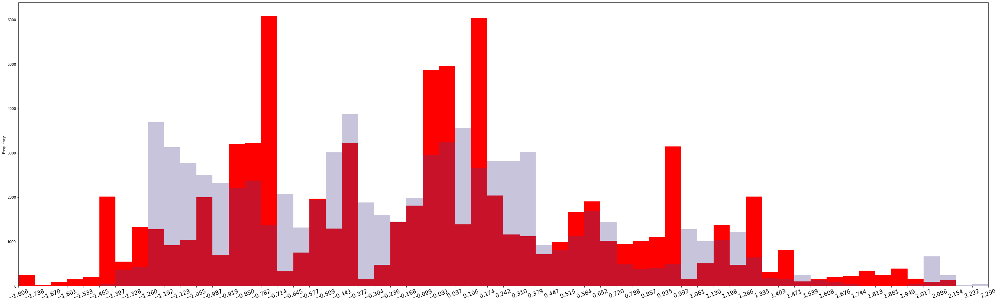

In [97]:
plot_y(test['stator_yoke'],y_test_pred_df['y_pred'])

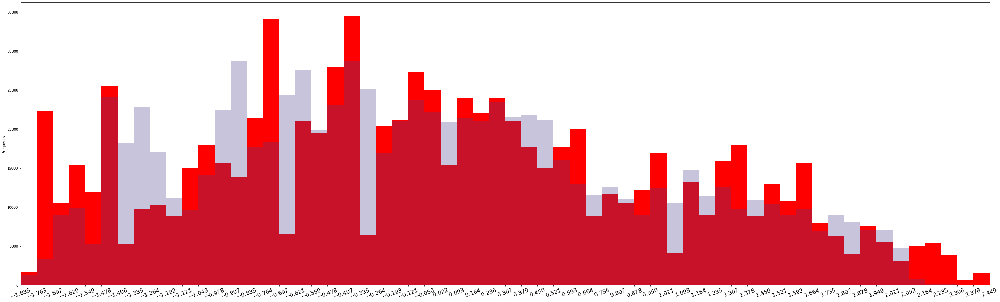

In [99]:
y_train_pred = model.predict(X_train)
y_train_pred_df=pd.DataFrame()
y_train_pred_df['y_pred'] = y_train_pred.flatten()

plot_y(train['stator_yoke'],y_train_pred_df['y_pred'])

###GMM

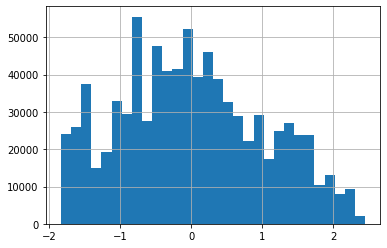

In [31]:
train['stator_yoke'].hist(bins = 30)

In [37]:
from sklearn.mixture import GaussianMixture

GMM = GaussianMixture(n_components = 1, covariance_type = 'spherical')

y_train_GMM_predict = GMM.fit_predict(X_train, y_4_train['stator_yoke'])
rmse(y_4_train['stator_yoke'],y_train_GMM_predict)

1.0306854131354186

### Linear Regression for each temperature variable
Variables are the vraiables with a high pearson correlation to the temperature variables. 

In [199]:
y_train_lr_predict = pd.DataFrame()
y_test_lr_predict = pd.DataFrame()
y_valid_lr = pd.DataFrame()
y_valid_lr_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = y_4_train[temperature]
  y_test = y_4_test[temperature]
  y_train_lr_predict[temperature], y_test_lr_predict[temperature],y_valid_lr[temperature], y_valid_lr_predict[temperature] = train_and_predict(X = X_train, y = y, X_test = X_test, y_test = y_test, model = False, exp = False, CV_5_stratified = True)


Model results for pm: 



/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
ambient           0.455534
coolant           0.318190
motor_speed       0.239529
torque            0.033788
log_u_abs         0.003571
u_phase_angle    -0.025675
log_i_abs         0.186775
i_phase_angle     0.001185
 RMSE training set: 0.6962517859756888              
 RMSE validation set: 0.8701109224277125              
 RMSE test set: 1.1726709442398404 

               Coefficient
ambient           0.415477
coolant           0.286567
motor_speed       0.349338
torque            0.060991
log_u_abs        -0.042204
u_phase_angle    -0.110490
log_i_abs         0.227914
i_phase_angle    -0.018828
 RMSE training set: 0.7337666342113588              
 RMSE validation set: 0.6910803786503172              
 RMSE test set: 1.0597816223694778 

               Coefficient
ambient           0.419065
coolant           0.315614
motor_speed       0.343851
torque            0.078644
log_u_abs        -0.001458
u_phase_angle    -0.082463
log_i_abs         0.245069
i_phase_

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
ambient           0.144259
coolant           0.884952
motor_speed       0.155806
torque            0.038557
log_u_abs        -0.018569
u_phase_angle     0.027770
log_i_abs         0.181878
i_phase_angle     0.018338
 RMSE training set: 0.361139959252182              
 RMSE validation set: 0.562483831872464              
 RMSE test set: 0.5710206787576624 

               Coefficient
ambient           0.086048
coolant           0.869839
motor_speed       0.214335
torque            0.076152
log_u_abs         0.018476
u_phase_angle     0.016464
log_i_abs         0.266541
i_phase_angle    -0.016543
 RMSE training set: 0.4034721833739325              
 RMSE validation set: 0.360424502891381              
 RMSE test set: 0.43653711657445604 

               Coefficient
ambient           0.080420
coolant           0.876417
motor_speed       0.203055
torque            0.086286
log_u_abs         0.053451
u_phase_angle     0.022428
log_i_abs         0.271525
i_phase_an

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
ambient           0.211244
coolant           0.730149
motor_speed       0.257442
torque            0.063645
log_u_abs        -0.007980
u_phase_angle     0.055153
log_i_abs         0.314603
i_phase_angle     0.018838
 RMSE training set: 0.49996927177158695              
 RMSE validation set: 0.8392040235536286              
 RMSE test set: 0.8501078181209086 

               Coefficient
ambient           0.120813
coolant           0.687298
motor_speed       0.371142
torque            0.120394
log_u_abs         0.047128
u_phase_angle     0.007583
log_i_abs         0.467128
i_phase_angle    -0.009230
 RMSE training set: 0.5674949119882289              
 RMSE validation set: 0.49830496240655725              
 RMSE test set: 0.6281835853050556 

               Coefficient
ambient           0.097000
coolant           0.703433
motor_speed       0.349591
torque            0.137809
log_u_abs         0.103252
u_phase_angle     0.016320
log_i_abs         0.467668
i_phas

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
ambient           0.159868
coolant           0.569784
motor_speed       0.341680
torque            0.144114
log_u_abs         0.090327
u_phase_angle     0.060116
log_i_abs         0.560450
i_phase_angle     0.004904
 RMSE training set: 0.6186793171344314              
 RMSE validation set: 0.7399598419114805              
 RMSE test set: 0.8112912426011525 

               Coefficient
ambient           0.130466
coolant           0.547466
motor_speed       0.422958
torque            0.163332
log_u_abs         0.062541
u_phase_angle    -0.004914
log_i_abs         0.656208
i_phase_angle     0.008411
 RMSE training set: 0.6273290754306433              
 RMSE validation set: 0.6692532258782098              
 RMSE test set: 0.7454073014035589 

               Coefficient
ambient           0.084949
coolant           0.549254
motor_speed       0.404962
torque            0.189918
log_u_abs         0.192922
u_phase_angle     0.018388
log_i_abs         0.650364
i_phase_

## Segregated Model

There are 4 groups that we can split the data based on the coolant and motor_speed. 
The cut point for the motor_speed is -1.2
and the cut point for the coolant is -1.

*   Group 1: (motor speed <= -1.2) and (coolant <= -1)
*   Group 2: (motor speed > -1.2)  and (coolant > -1)
*   Group 3: (motor speed > -1.2)  and (coolant <= -1)
*   Group 4: (motor speed <= -1.2) and (coolant > -1)




In [221]:
g1_test = test[(test['motor_speed']<=-1.2) & (test['coolant']<=-1)]
g2_test = test[(test['motor_speed']>-1.2) & (test['coolant']>-1)]
g3_test = test[(test['motor_speed']>-1.2) & (test['coolant']<=-1)]
g4_test = test[(test['motor_speed']<=-1.2) & (test['coolant']>-1)]

g1 = train[(train['motor_speed']<=-1.2) & (train['coolant']<=-1)]
g2 = train[(train['motor_speed']>-1.2) & (train['coolant']>-1)]
g3 = train[(train['motor_speed']>-1.2) & (train['coolant']<=-1)]
g4 = train[(train['motor_speed']<=-1.2) & (train['coolant']>-1)]

# g_list=['g1','g2','g3','g4']

# groups = {}

# for i in ['g1','g2','g3','g4']:
#      train_name = 'train_' + i # the name for the dataframe
#      test_name = 'test_' + i # the name for the dataframe
#     #  groups[train_name] = train[i]
#     #  groups[test_name] = test[i]
#     #  print(groups[train_name].shape,groups[test_name].shape)

# # train_g1 
# train_g2
# train_g3
# train_g4
# test_g1
# test_g2
# test_g3
# test_g4

In [225]:
X_columns = ['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs', 'u_phase_angle', 'log_i_abs', 'i_phase_angle']

g1[X_columns]

,ambient,coolant,motor_speed,torque,log_u_abs,u_phase_angle,log_i_abs,i_phase_angle
0,-0.752143,-1.118446,-1.222428,-0.250182,0.291659,-1.323302,0.056873,-0.234408
1,-0.771263,-1.117021,-1.222429,-0.249133,0.291853,-1.322019,0.056808,-0.234397
2,-0.782892,-1.116681,-1.222428,-0.249431,0.295412,-1.320535,0.056749,-0.234397
3,-0.780935,-1.116764,-1.222430,-0.248636,0.295605,-1.319872,0.060115,-0.234695
4,-0.774043,-1.116775,-1.222429,-0.248701,0.296796,-1.319021,0.059088,-0.234606
...,...,...,...,...,...,...,...,...
783188,0.632490,-1.024600,-1.222429,-0.255640,0.311284,-1.335099,0.056446,-0.234371
783189,0.633289,-1.018545,-1.222427,-0.255640,0.310956,-1.334916,0.056442,-0.234387
783190,0.631832,-1.012482,-1.222431,-0.255640,0.312009,-1.335430,0.056447,-0.234370
783191,0.629651,-1.007142,-1.222430,-0.255640,0.310680,-1.334662,0.056446,-0.234379


In [229]:
y_train_g1_lr_predict = pd.DataFrame()
y_test_g1_lr_predict = pd.DataFrame()
y_valid_lr = pd.DataFrame()
y_valid_lr_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = g1[temperature]
  y_test = g1_test[temperature]
  y_train_g1_lr_predict[temperature], y_test_g1_lr_predict[temperature] = train_and_predict(X = g1[X_columns], y = y, X_test = g1_test[X_columns], y_test = y_test, model = False, exp = False, CV_5_stratified = False)



Model results for pm: 

               Coefficient
ambient           1.462009
coolant          -0.331299
motor_speed     -93.778748
torque          -13.483280
log_u_abs       -48.610109
u_phase_angle    41.913462
log_i_abs        -3.823229
i_phase_angle     7.168403
 RMSE training set: 0.655200864728969            
 RMSE test set: 1.6698424370802125 

Model results for stator_yoke: 

               Coefficient
ambient           0.420978
coolant           2.594178
motor_speed     -20.370798
torque           -8.449775
log_u_abs       -11.436036
u_phase_angle    14.344237
log_i_abs        -3.800846
i_phase_angle     6.307650
 RMSE training set: 0.427478678519518            
 RMSE test set: 0.5117848385828174 

Model results for stator_tooth: 

               Coefficient
ambient           0.543897
coolant           3.130998
motor_speed     -17.564456
torque          -10.930258
log_u_abs       -15.356603
u_phase_angle    19.557611
log_i_abs        -4.507824
i_phase_angle     8.306296
 RMSE 

In [230]:
y_train_g2_lr_predict = pd.DataFrame()
y_test_g2_lr_predict = pd.DataFrame()
y_valid_lr = pd.DataFrame()
y_valid_lr_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = g2[temperature]
  y_test = g2_test[temperature]
  y_train_g2_lr_predict[temperature], y_test_g2_lr_predict[temperature] = train_and_predict(X = g2[X_columns], y = y, X_test = g2_test[X_columns], y_test = y_test, model = False, exp = False, CV_5_stratified = False)

Model results for pm: 

               Coefficient
ambient           0.517532
coolant           0.427903
motor_speed       0.233805
torque           -0.000130
log_u_abs        -0.051586
u_phase_angle    -0.019521
log_i_abs         0.107867
i_phase_angle    -0.033610
 RMSE training set: 0.6130657032941317            
 RMSE test set: 0.9202147209982068 

Model results for stator_yoke: 

               Coefficient
ambient           0.181453
coolant           0.862114
motor_speed       0.037808
torque            0.041838
log_u_abs         0.095045
u_phase_angle     0.005642
log_i_abs         0.117401
i_phase_angle    -0.000391
 RMSE training set: 0.34721932623574653            
 RMSE test set: 0.42308609821707077 

Model results for stator_tooth: 

               Coefficient
ambient           0.246552
coolant           0.678721
motor_speed       0.097402
torque            0.069213
log_u_abs         0.160838
u_phase_angle    -0.002068
log_i_abs         0.218647
i_phase_angle     0.001458
 R

In [231]:
y_train_g3_lr_predict = pd.DataFrame()
y_test_g3_lr_predict = pd.DataFrame()
y_valid_lr = pd.DataFrame()
y_valid_lr_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = g3[temperature]
  y_test = g3_test[temperature]
  y_train_g3_lr_predict[temperature], y_test_g3_lr_predict[temperature] = train_and_predict(X = g3[X_columns], y = y, X_test = g3_test[X_columns], y_test = y_test, model = False, exp = False, CV_5_stratified = False)




Model results for pm: 

               Coefficient
ambient           0.437545
coolant           2.526042
motor_speed       0.630007
torque            0.131644
log_u_abs        -0.187070
u_phase_angle    -0.138698
log_i_abs         0.599190
i_phase_angle     0.177668
 RMSE training set: 0.8142498600828032            
 RMSE test set: 0.9667680992993325 

Model results for stator_yoke: 

               Coefficient
ambient           0.065950
coolant           2.780356
motor_speed       0.271731
torque            0.141981
log_u_abs         0.086568
u_phase_angle    -0.030249
log_i_abs         0.437406
i_phase_angle     0.029398
 RMSE training set: 0.40733551186640754            
 RMSE test set: 0.3867394234456972 

Model results for stator_tooth: 

               Coefficient
ambient           0.090550
coolant           3.890702
motor_speed       0.463911
torque            0.217538
log_u_abs         0.131459
u_phase_angle    -0.058013
log_i_abs         0.765434
i_phase_angle     0.032069
 RM

In [232]:
y_train_g4_lr_predict = pd.DataFrame()
y_test_g4_lr_predict = pd.DataFrame()
y_valid_lr = pd.DataFrame()
y_valid_lr_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = g4[temperature]
  y_test = g4_test[temperature]
  y_train_g4_lr_predict[temperature], y_test_g4_lr_predict[temperature] = train_and_predict(X = g4[X_columns], y = y, X_test = g4_test[X_columns], y_test = y_test, model = False, exp = False, CV_5_stratified = False)




Model results for pm: 

               Coefficient
ambient           0.357671
coolant           0.255549
motor_speed      22.171610
torque            0.293346
log_u_abs         3.553974
u_phase_angle    -3.443016
log_i_abs        -0.579735
i_phase_angle     0.534027
 RMSE training set: 0.6212116757422064            
 RMSE test set: 1.1370652567633301 

Model results for stator_yoke: 

               Coefficient
ambient           0.055586
coolant           0.921564
motor_speed      29.573451
torque            0.217857
log_u_abs         2.298646
u_phase_angle    -0.111757
log_i_abs         0.492883
i_phase_angle     0.282589
 RMSE training set: 0.3703358903586353            
 RMSE test set: 0.4743730946781068 

Model results for stator_tooth: 

               Coefficient
ambient           0.057841
coolant           0.776821
motor_speed      48.144534
torque            0.354720
log_u_abs         2.893632
u_phase_angle     0.175108
log_i_abs         0.777347
i_phase_angle     0.433781
 RMS

In [220]:
g1 = ((train['motor_speed']<=-1.2) & (train['coolant']<=-1))
g2 = ((train['motor_speed']>-1.2) & (train['coolant']>-1))
g3 = ((train['motor_speed']>-1.2) & (train['coolant']<=-1))
g4 = ((train['motor_speed']<=-1.2) & (train['coolant']>-1))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


IndexingError: ignored

In [126]:
X_test.drop('pm',axis=1, inplace=True)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [128]:
X_train_pm = pd.concat([X_train,y_train_predict['pm']],axis=1)
X_test_pm = pd.concat([X_test,y_test_predict['pm']],axis=1)
print(X_train.head())
X_test_pm.head()
print(X_train_pm.shape,X_test_pm.shape)
print(X_train.shape,X_test.shape,y_test_predict.shape,y_train_predict['pm'].shape )
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = y_4_train[temperature]
  y_test = y_4_test[temperature]
  y_train_predict[temperature], y_test_predict[temperature] = train_and_predict(X = X_train_pm, y = y, X_test = X_test_pm, y_test = y_test, model = False, exp = False, CV_5_stratified = False)


    ambient   coolant  motor_speed  ...  u_phase_angle     i_abs  i_phase_angle
0 -0.752143 -1.118446    -1.222428  ...      -1.323302  1.058521      -0.234408
1 -0.771263 -1.117021    -1.222429  ...      -1.322019  1.058453      -0.234397
2 -0.782892 -1.116681    -1.222428  ...      -1.320535  1.058390      -0.234397
3 -0.780935 -1.116764    -1.222430  ...      -1.319872  1.061958      -0.234695
4 -0.774043 -1.116775    -1.222429  ...      -1.319021  1.060869      -0.234606

[5 rows x 8 columns]
(846368, 9) (76423, 9)
(846368, 8) (76423, 8) (76423, 4) (846368,)
Model results for pm: 

                Coefficient
ambient       -3.039562e-16
coolant        7.771561e-16
motor_speed    6.938894e-17
torque        -6.661338e-16
u_abs         -5.828671e-16
u_phase_angle  1.387779e-16
i_abs         -5.898060e-17
i_phase_angle -8.673617e-19
pm             1.000000e+00
 RMSE training set: 9.627259029210148e-16            
 RMSE test set: 9.808416890899776e-16 

Model results for stator_yoke: 



In [27]:
X_columns = ['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs', 'u_phase_angle', 'cut_point_torque','cut_point_motor', 'i_abs', 'i_phase_angle']
y_4_columns= ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']

X_train = train[X_columns]
X_train['int1'] = X_train['cut_point_torque']*X_train['torque']
X_train['int2'] = X_train['cut_point_motor']*X_train['motor_speed']
X_train['int3'] = X_train['cut_point_motor']*X_train['cut_point_torque']*X_train['log_u_abs']
y_4_train = train[y_4_columns]
X_test = test[X_columns]
X_test['int1'] = X_test['cut_point_torque']*X_test['torque']
X_test['int2'] = X_test['cut_point_motor']*X_test['motor_speed']
X_test['int3'] = X_test['cut_point_motor']*X_test['cut_point_torque']*X_test['log_u_abs']

y_4_test = test[y_4_columns]

y_train_predict = pd.DataFrame()
y_test_predict = pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = y_4_train[temperature]
  y_test = y_4_test[temperature]
  y_train_predict[temperature], y_test_predict[temperature] = train_and_predict(X = X_train, y = y, X_test = X_test, y_test = y_test, model = False, exp = False, CV_5_stratified = False)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:178: UserWarning: evaluating in Python space because the '*' operator is not supported by numexpr for the bool dtype, use '&' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/

Model results for pm: 

                  Coefficient
ambient              0.424798
coolant              0.309650
motor_speed         -0.076285
torque              -0.465174
log_u_abs            0.031565
u_phase_angle        0.038048
cut_point_torque    -0.407546
cut_point_motor      0.263019
i_abs                0.455451
i_phase_angle       -0.000344
int1                 0.684827
int2                 0.391316
int3                -0.159791
 RMSE training set: 0.704549054137229            
 RMSE test set: 1.0119638033907643 

Model results for stator_yoke: 

                  Coefficient
ambient              0.095852
coolant              0.872664
motor_speed          0.254144
torque               0.152682
log_u_abs            0.037550
u_phase_angle        0.009242
cut_point_torque    -0.069701
cut_point_motor     -0.072314
i_abs                0.146728
i_phase_angle       -0.005494
int1                -0.246173
int2                -0.036884
int3                -0.162186
 RMSE training s

In [62]:
from sklearn.ensemble import RandomForestRegressor
regr = RandomForestRegressor(max_depth=20, random_state=42)
y_predict=pd.DataFrame()
y_test_predict=pd.DataFrame()
for temperature in y_4_columns:
  print(f'Model results for {temperature}: \n')
  y = y_4_train[temperature]
  y_test = y_4_test[temperature]
  regr.fit(X_train, y)
  y_train_predict[temperature] = regr.predict(X_train)
  y_test_predict[temperature] = regr.predict(X_test)
  print(f' RMSE training set: {rmse(y_train_predict[temperature], y, squared = False)}\
        \n RMSE test set: {rmse(y_test_predict[temperature], y_test, squared = False)} \n')

Model results for pm: 

 RMSE training set: 0.08890008034944691        
 RMSE test set: 1.0261919885352946 

Model results for stator_yoke: 



ValueError: ignored

In [67]:
rmse(y_train_predict[temperature], y, squared = False)
rmse(y_test_predict[temperature], y_test, squared = False)

0.4992062436112651

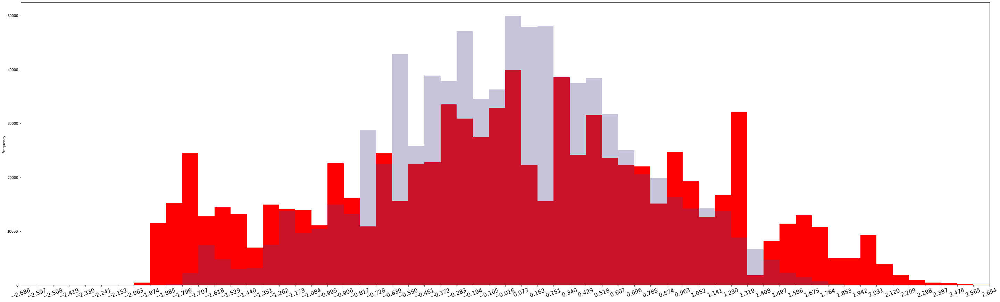

In [90]:
temperature= 'stator_winding'
plot_y(y_4_train[temperature], y_train_predict[temperature])


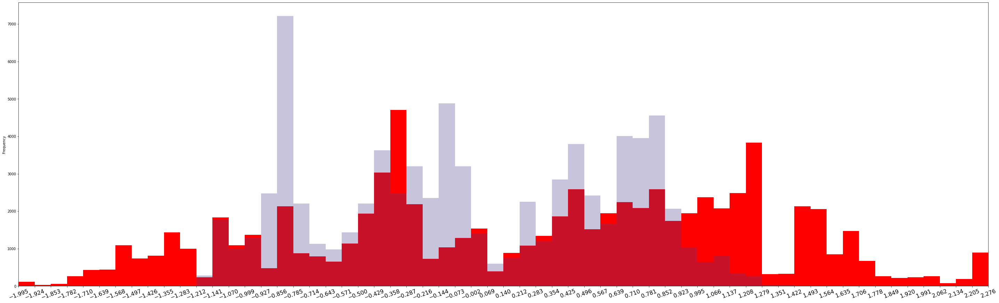

In [91]:
plot_y(y_4_test[temperature], y_test_predict[temperature])

In [95]:
y_4_train.describe(percentiles = [0.05,0.1,0.25,0.5,0.75,0.9,0.95])


,pm,stator_yoke,stator_tooth,stator_winding
count,846368.000000,846368.000000,846368.000000,846368.000000
mean,-0.000441,0.012695,0.000753,-0.008259
std,0.991628,1.015148,1.006694,0.997647
min,-2.628648,-1.834688,-2.066143,-2.019973
5%,-1.819922,-1.573486,-1.734224,-1.744125
10%,-1.419102,-1.409087,-1.493684,-1.493157
25%,-0.656185,-0.736750,-0.761951,-0.723910
50%,0.083156,-0.052310,0.012339,0.009469
75%,0.684179,0.728644,0.778085,0.707115
90%,1.257657,1.473680,1.335732,1.261606


In [96]:
y_4_test.describe(percentiles = [0.05,0.1,0.25,0.5,0.75,0.9,0.95])


,pm,stator_yoke,stator_tooth,stator_winding
count,76423.000000,76423.000000,76423.000000,76423.000000
mean,0.137150,-0.075152,0.128581,0.256473
std,0.967739,0.804108,0.857733,0.959457
min,-2.631991,-1.806231,-2.049122,-1.995189
5%,-1.638285,-1.291504,-1.360389,-1.362106
10%,-1.156006,-1.067620,-1.067903,-1.096854
25%,-0.571135,-0.768501,-0.523926,-0.422462
50%,0.274873,-0.045929,0.253187,0.397438
75%,0.790400,0.479266,0.773528,1.029436
90%,1.282041,1.048166,1.178989,1.485991


In [ ]:

y=finalDf['pm']
from sklearn.linear_model import LinearRegression, LogisticRegression
X = finalDf[['pc_1', 'pc_2', 'pc_3']]
y = finalDf['pm']
# model = LinearRegression()
model = LogisticRegression()
clf = model.fit(X, y)
y_predicted = clf.predict(X)
clf.score


### Set Features to Model

 The maximum value of y is :2.92
 The minimum value of y is: -2.63


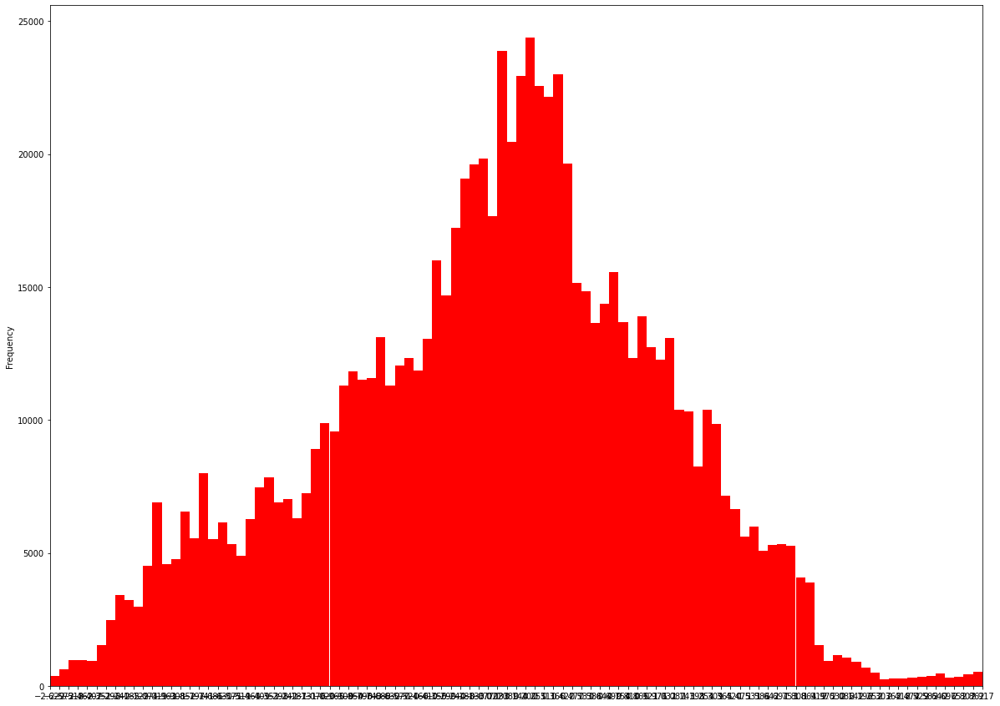

In [ ]:
'''
List of all available features
['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
 'i_q', 'u', 'u_abs', 'u_q_d_ratio', 'u_phase_angle', 'log_u_abs', 'i',
 'i_abs', 'i_q_d_ratio', 'i_phase_angle', 'log_i_abs', 'pm',
 'stator_yoke', 'stator_tooth', 'stator_winding']
'''

y = train['pm']

print(f' The maximum value of y is :{np.max(y):.2f}\n The minimum value of y is: {np.min(y):.2f}')

count, bin_edges = np.histogram(y, 100)
y.plot(kind='hist',
          figsize=(20, 15), 
          bins=100,
          xticks=bin_edges,
          color='red',
          xlim=(np.min(y), np.max(y))
         )

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_squared_error as rmse

X = train[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque']]
y = train['pm']
X_test = test[X.columns]
y_test = test['pm']
bins = np.linspace(np.min(y), np.max(y), 10) 
y_binned = np.digitize(y, bins)

skf = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)
skf.get_n_splits(X, y_binned)
print(skf)

StratifiedKFold(n_splits=5, random_state=None, shuffle=False)


In [23]:
def plot_residulas(y, y_predict):
  residuals = np.abs(y-y_predict)
  count, bin_edges = np.histogram(residuals, 60)
  residuals.plot(kind='hist',
          figsize=(50, 15), 
          bins=60,
          xticks=bin_edges,
          color='red',
          xlim=(np.min(residuals), np.max(residuals))
         )

In [ ]:
X1 = train[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque','stator_yoke']]
y1 = train['pm']
X_test = test[X1.columns]
y_test = test['pm']

X_test.head()

,coolant,ambient,u_abs,u_phase_angle,motor_speed,torque,stator_yoke
0,-1.073478,-2.749564,1.338842,-1.316764,-1.222426,-0.248547,-1.800853
1,-1.072823,-2.749612,1.341814,-1.315374,-1.222425,-0.247740,-1.801808
2,-1.073277,-2.746339,1.343109,-1.314271,-1.222428,-0.247232,-1.802578
3,-1.074854,-2.747337,1.344523,-1.313626,-1.222428,-0.246810,-1.801862
4,-1.076696,-2.748052,1.346500,-1.312419,-1.222429,-0.246473,-1.801228


In [ ]:
y_train, y_valid, y_train_predict, y_valid_predict, y_test_predict = train_and_predict(X1, y1, X_test, y_test)


/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
coolant          -0.638380
ambient           0.335904
u_abs             0.005558
u_phase_angle    -0.078587
motor_speed       0.062121
torque           -0.034170
stator_yoke       1.108720
 RMSE training set: 0.5253843177777118            
 RMSE validation set: 0.6659999128919644            
 RMSE test set: 0.7771840060579185 

               Coefficient
coolant          -0.768939
ambient           0.299554
u_abs            -0.059222
u_phase_angle    -0.134679
motor_speed       0.108330
torque           -0.014539
stator_yoke       1.214474
 RMSE training set: 0.5521330674689636            
 RMSE validation set: 0.5349515021787964            
 RMSE test set: 0.6714951630566924 

               Coefficient
coolant          -0.807166
ambient           0.284562
u_abs            -0.110689
u_phase_angle    -0.110859
motor_speed       0.105810
torque           -0.034359
stator_yoke       1.278518
 RMSE training set: 0.549864946561882            
 RMSE validation set

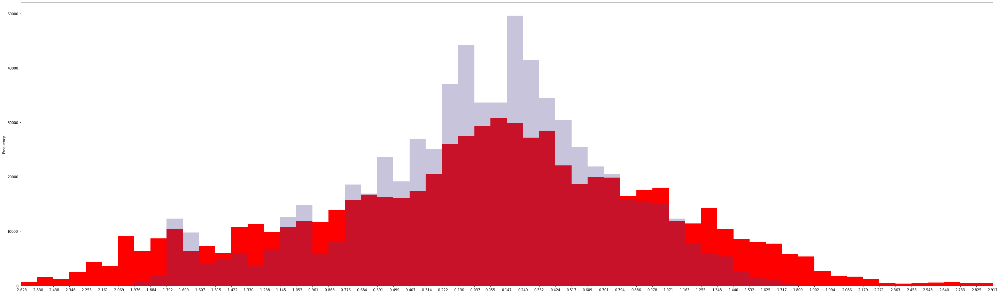

In [ ]:
plot_y(y_train, y_train_predict);

In [ ]:
y_train, y_train_predict

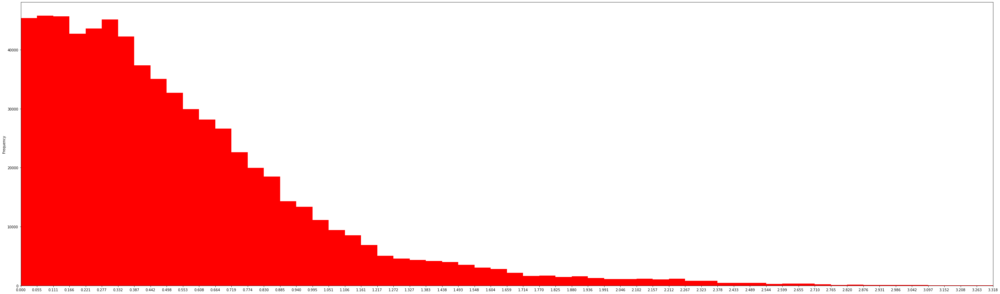

In [ ]:
plot_residulas(y_train, y_train_predict)

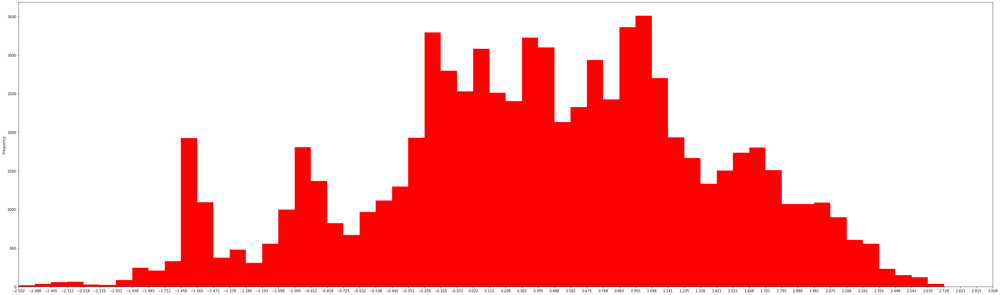

In [ ]:
plot_residulas(y_test, y_test_predict)

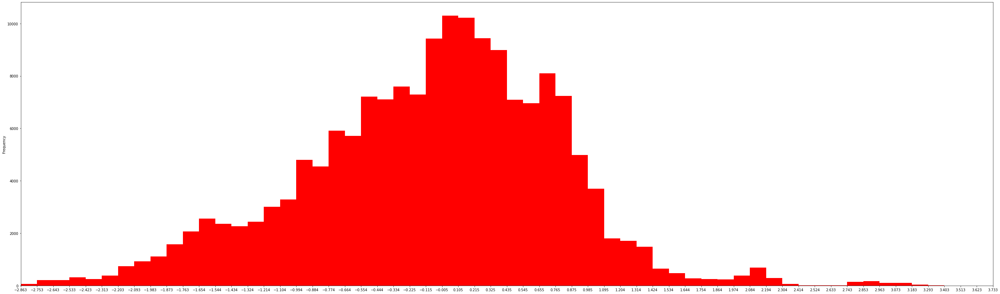

In [ ]:
plot_residulas(y_valid,y_valid_predict)

In [ ]:
pip install more-itertools

In [ ]:
from more_itertools import pairwise
from scipy.stats import iqr

In [ ]:
resiudals = np.abs(y_test- y_test_predict)
percentiles = [0, 0.05 ,0.1 ,0.25 ,0.5 ,0.75 ,0.9 ,0.95, 1]
pair_percentiles = pairwise(percentiles)

In [ ]:
for i,k in pair_percentiles:
  
  print(f'The sum of residuals between the {k} and the {i} percentiles is {sum(resiudals[resiudals<np.quantile(resiudals, i)]) - sum(resiudals[resiudals<np.quantile(resiudals, k)])}')

The sum of residuals between the 0.05 and the 0 percentiles is -134.09739110165833
The sum of residuals between the 0.1 and the 0.05 percentiles is -364.4141309318723
The sum of residuals between the 0.25 and the 0.1 percentiles is -2573.790832688583
The sum of residuals between the 0.5 and the 0.25 percentiles is -10616.335304706216
The sum of residuals between the 0.75 and the 0.5 percentiles is -19473.954175268867
The sum of residuals between the 0.9 and the 0.75 percentiles is -17608.07040591009
The sum of residuals between the 0.95 and the 0.9 percentiles is -7068.508169662942
The sum of residuals between the 1 and the 0.95 percentiles is -8405.016404369344


catboost regressor

In [ ]:
class RmseObjective(object):
    def calc_ders_range(self, approxes, targets, weights):
        assert len(approxes) == len(targets)
        if weights is not None:
            assert len(weights) == len(approxes)
        
        result = []
        for index in range(len(targets)):
            der1 = targets[index] - approxes[index]
            der2 = -1

            if weights is not None:
                der1 *= weights[index]
                der2 *= weights[index]

            result.append((der1, der2))
        return result

In [ ]:
!pip install catboost

     |████████████████████████████████| 65.9MB 59kB/s 


In [69]:
X_train.columns

Index(['ambient', 'coolant', 'motor_speed', 'torque', 'log_u_abs',
       'u_phase_angle', 'cut_point_torque', 'cut_point_motor', 'i_abs',
       'i_phase_angle', 'int1', 'int2', 'int3'],
      dtype='object')

In [ ]:
from catboost import CatBoostRegressor
model = CatBoostRegressor(iterations=10000
                          , learning_rate=0.1
                          , depth=16
                          , eval_metric = 'RMSE'
                          , bootstrap_type='Bayesian'
                          , bagging_temperature = 20
                          , task_type = 'GPU'
                          , boost_from_average = True
                          , grow_policy= 'Lossguide'
                          )
                          # , cat_features = ['cut_point_torque', 'cut_point_motor'])

y_train_predict = pd.DataFrame()
y_test_predict = pd.DataFrame()
for temperature in y_4_columns:
  y = y_4_train[temperature]
  y_test = y_4_test[temperature]
  # Fit model
  model.fit(np.array(X_train), np.array(y))
  # Get predictions
  # preds_train = model.predict(np.array(X))
  # preds_test = model.predict(np.array(X_test))
  # print(f'RMSE training set: {rmse(preds_train, y, squared = False)}\n RMSE validation set: {rmse(preds_test, y_test, squared = False)}')
  #       # \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)} \n') 

  y_train_predict['cat' + temperature] = model.predict(X_train)
  y_test_predict['cat' + temperature] = model.predict(X_test)
  # print(f' RMSE training set: {rmse(y_train_predict['cat' + temperature], y, squared = False)}\
  #       \n RMSE test set: {rmse(y_test_predict['cat' + temperature], y_test, squared = False)} \n')

In [31]:
for temperature in y_4_columns:
  print(rmse(y_train_predict['cat' + temperature], y_4_train[temperature], squared = False),rmse(y_test_predict['cat' + temperature], y_4_test[temperature], squared = False))
  # print(rmse(y_train_predict[temperature], y, squared = False),rmse(y_test_predict[temperature], y_test, squared = False))

0.3148761960467357 1.0250433840978699
0.22360209875813877 0.45750420683632254
0.2991344377165527 0.6261718720965338
0.32915149466740323 0.7279039414233613


In [87]:
for temperature in y_4_columns:
  print(rmse(y_train_predict['cat' + temperature], y_4_train[temperature], squared = False),rmse(y_test_predict['cat' + temperature], y_4_test[temperature], squared = False))
  # print(rmse(y_train_predict[temperature], y, squared = False),rmse(y_test_predict[temperature], y_test, squared = False))

0.3039111372164855 0.9916436302908684
0.21801598371237652 0.4395763494147015
0.29168524930696954 0.579130987720224
0.32727166049413764 0.6390969034506426


In [ ]:
bins = np.linspace(np.min(y), np.max(y), 10) 
y_binned = np.digitize(y, bins)
skf = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)
skf.get_n_splits(X, y_binned)
model = LinearRegression()
for train_index, test_index in skf.split(X, y_binned):
  X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
  y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
  model.fit(X_train, y_train)
  coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])  
  print(coeff_df)
  
  y_train_predict = model.predict(X_train)
  y_valid_predict = model.predict(X_valid)
  y_test_predict = model.predict(X_test)
  print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)}\
      \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)}\
      \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)} \n') 

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
coolant           0.307944
ambient           0.450057
u_abs             0.102610
u_phase_angle     0.008603
motor_speed       0.180474
torque            0.044894
 RMSE training set: 0.701239479666413      
 RMSE validation set: 0.8928469577156078      
 RMSE test set: 1.20227826682338 

               Coefficient
coolant           0.275799
ambient           0.405490
u_abs             0.069461
u_phase_angle    -0.069283
motor_speed       0.292396
torque            0.075549
 RMSE training set: 0.7411701971820388      
 RMSE validation set: 0.7047312195977066      
 RMSE test set: 1.0960740217847753 

               Coefficient
coolant           0.296858
ambient           0.414590
u_abs             0.113366
u_phase_angle    -0.043088
motor_speed       0.283157
torque            0.092681
 RMSE training set: 0.7574930861391374      
 RMSE validation set: 0.6305553730442026      
 RMSE test set: 1.081544208457501 

               Coefficient
coolant           0.273

(array([2.00000e+00, 2.00000e+00, 2.40000e+01, 3.19370e+04, 5.10060e+04,
        1.17781e+05, 2.38091e+05, 1.65079e+05, 6.69060e+04, 6.26700e+03]),
 array([-3.73708081, -3.16329483, -2.58950885, -2.01572287, -1.44193689,
        -0.86815091, -0.29436493,  0.27942104,  0.85320702,  1.426993  ,
         2.00077898]),
 <a list of 10 Patch objects>)

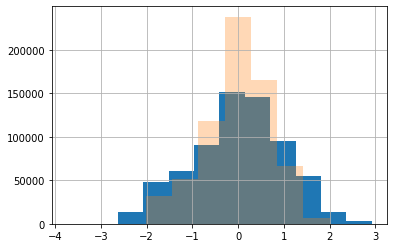

In [ ]:
y_train.hist()
plt.hist(y_train_predict, alpha=0.3)

In [ ]:
np.std(train['stator_yoke'])

1.0151474032063152

In [ ]:
X = train_error[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque']]
y = train_error['stator_yoke']
X_test = test[X.columns][test['stator_yoke']<-1.4]
y_test = test['stator_yoke'][test['stator_yoke']<-1.4]


In [ ]:
y_train, y_valid, y_train_predict, y_valid_predict, y_test_predict = train_and_predict(exp = True)

In [ ]:
y = np.exp(y+10)
y_test = np.exp(y_test+10)
bins = np.linspace(np.min(y), np.max(y), 10) 
y_binned = np.digitize(y, bins)
skf = StratifiedKFold(n_splits=5, random_state=None, shuffle=False)
skf.get_n_splits(X, y_binned)

model = LinearRegression()
for train_index, test_index in skf.split(X, y_binned):
  X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
  y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
  model.fit(X_train, y_train)
  coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])  
  print(coeff_df)
  
  y_train_predict = model.predict(X_train)
  y_valid_predict = model.predict(X_valid)
  y_test_predict = model.predict(X_test)

 
  print(f' RMSE training set: {rmse(np.log(y_train_predict), np.log(y_train), squared = False)}\
          \n RMSE validation set: {rmse(np.log(y_valid_predict), np.log(y_valid), squared = False)}\
          \n RMSE test set: {rmse(np.log(y_test_predict), np.log(y_test), squared = False)} \n')

  print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)}\
        \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)}\
        \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)} \n') 

In [ ]:
np.log(y_test_predict)

array([-0.47015289, -0.47038074, -0.47035628, ...,  1.50046322,
        1.58289881,  1.58063535])

(array([2.4497e+04, 3.5864e+04, 3.4079e+04, 2.7200e+04, 2.1938e+04,
        3.8428e+04, 1.9722e+04, 2.1492e+04, 2.7820e+04, 2.8016e+04,
        2.9151e+04, 2.2124e+04, 1.7875e+04, 1.2244e+04, 8.6580e+03,
        1.3718e+04, 9.2850e+03, 8.6570e+03, 9.3510e+03, 2.1034e+04,
        1.3048e+04, 1.2746e+04, 1.1789e+04, 1.3715e+04, 1.0840e+04,
        5.9710e+03, 5.5690e+03, 6.1730e+03, 3.5970e+03, 1.1100e+03,
        1.9000e+01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00]),
 array([  5431.6889224 ,   9584.51419881,  13737.33947522,  17890.16475163,
         22042.99002804,  26195.81530445,  30348.64058086,  34501.46585727,
         38654.29113368,  4280

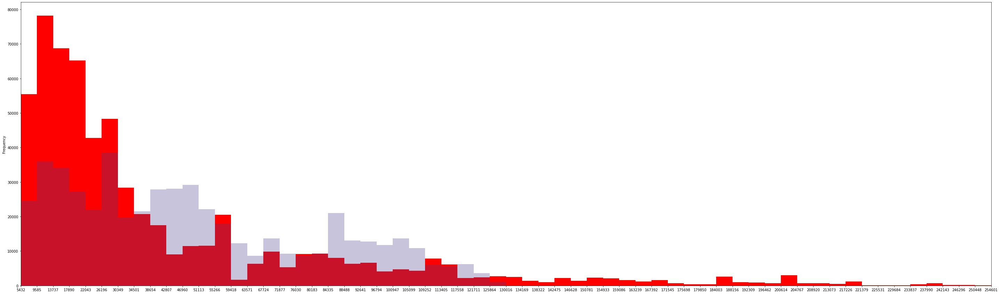

In [ ]:
# plt.hist(y_train-y_train_predict, bins = 30)
# y_train.plot(kind ='hist', 
#           figsize=(10, 6),
#           bins=15,
#           alpha=0.6,
#           xticks=bin_edges,
#           color=['coral', 'darkslateblue', 'mediumseagreen']
#          )

count, bin_edges = np.histogram(y_train, 60)

y_train.plot(kind='hist',
          figsize=(50, 15), 
          bins=60,
          xticks=bin_edges,
          color='red',
          xlim=(np.min(y_train), np.max(y_train))
         )
# plt.figure(figsize=(10,10))
# plt.hist(y_train, bins = 30, alpha = 0.6, color='red')
plt.hist(y_train_predict, bins = bin_edges, alpha = 0.3, color = 'darkslateblue')

In [ ]:
X = train_error[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque']]
y = train_error['stator_yoke']
X_test = test[X.columns]
y_test = test['stator_yoke']
bins = np.linspace(np.min(y), np.max(y), 10) 
y_binned = np.digitize(y, bins)


In [ ]:
test[X.columns]

,coolant,ambient,u_abs,u_phase_angle,motor_speed,torque
0,-1.073478,-2.749564,1.338842,-1.316764,-1.222426,-0.248547
1,-1.072823,-2.749612,1.341814,-1.315374,-1.222425,-0.247740
2,-1.073277,-2.746339,1.343109,-1.314271,-1.222428,-0.247232
3,-1.074854,-2.747337,1.344523,-1.313626,-1.222428,-0.246810
4,-1.076696,-2.748052,1.346500,-1.312419,-1.222429,-0.246473
...,...,...,...,...,...,...
76418,1.633554,0.688609,1.314730,-1.332661,0.273299,1.010686
76419,1.633553,0.688609,1.314730,-1.332661,0.265776,1.047163
76420,1.633745,0.688609,0.974379,-1.344431,0.258588,1.088225
76421,1.633884,0.688609,0.840459,1.229138,0.327896,1.130760


In [ ]:
for train_index, test_index in skf.split(X, y_binned):
  X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
  y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
  model.fit(X_train, y_train)
  coeff_df = pd.DataFrame(model.coef_, X.columns, columns=['Coefficient'])  
  print(coeff_df)
  y_train_predict = model.predict(X_train)
  y_valid_predict = model.predict(X_valid)
  y_test_predict = model.predict(X_test)
  print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)}\
        \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)}\
        \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)} \n')

               Coefficient
coolant           0.380980
ambient           0.027568
u_abs            -0.068447
u_phase_angle     0.019032
motor_speed       0.063637
torque            0.036834
 RMSE training set: 0.10726386199296178        
 RMSE validation set: 0.12052283389386628        
 RMSE test set: 1.297041006058793 

               Coefficient
coolant           0.391505
ambient           0.018171
u_abs            -0.034086
u_phase_angle     0.022451
motor_speed       0.054663
torque            0.031057
 RMSE training set: 0.11127239291028679        
 RMSE validation set: 0.1012223779741029        
 RMSE test set: 1.29005176770721 

               Coefficient
coolant           0.424024
ambient           0.015174
u_abs            -0.011387
u_phase_angle     0.037128
motor_speed       0.033087
torque            0.032151
 RMSE training set: 0.10748501613036207        
 RMSE validation set: 0.12074708468437273        
 RMSE test set: 1.2771480092236427 

               Coefficient
coola

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


In [ ]:
for train_index, test_index in skf.split(X, y_binned):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    # X_train = np.array(X_train).reshape(-1,1)
    # X_valid = np.array(X_valid).reshape(-1,1)
    reg.fit(X_train, y_train)
    coeff_list = list(X.columns)
    coeff_list.insert(0,'Intercept')
    coeff_values = np.append(reg.intercept_,reg.coef_)
    coeff_df = pd.DataFrame(coeff_values, coeff_list, columns=['Coefficient'])
    print( coeff_df)
    y_train_predict = reg.predict(X_train)
    y_valid_predict = reg.predict(X_valid)
    y_test_predict = reg.predict(X_test)
    print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)} \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)} \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)}')

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
Intercept        -0.086825
coolant           0.877657
ambient           0.142468
u_abs             0.022313
u_phase_angle     0.064932
motor_speed       0.109741
torque            0.033335
 RMSE training set: 0.3714231628856854 
 RMSE validation set: 0.6066755532342379 
 RMSE test set: 0.611854010691963
               Coefficient
Intercept        -0.193096
coolant           0.855129
ambient           0.076268
u_abs             0.143041
u_phase_angle     0.053702
motor_speed       0.153968
torque            0.098518
 RMSE training set: 0.4197076218650637 
 RMSE validation set: 0.38968709056389994 
 RMSE test set: 0.4721342007427099
               Coefficient
Intercept        -0.227610
coolant           0.856166
ambient           0.077403
u_abs             0.179748
u_phase_angle     0.065930
motor_speed       0.134145
torque            0.111437
 RMSE training set: 0.4185415085514284 
 RMSE validation set: 0.39453892166952476 
 RMSE test set: 0.46092957600497086

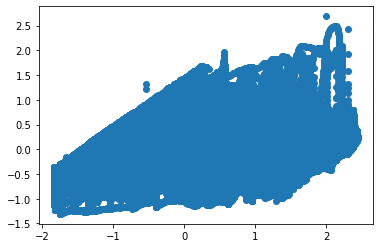

In [ ]:
plt.scatter(y_train, y_train-y_train_predict)

(array([0.0000e+00, 1.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00,
        4.2080e+03, 8.3290e+03, 1.7829e+04, 1.4296e+04, 2.5681e+04,
        1.6858e+04, 1.2438e+04, 1.7278e+04, 2.2120e+04, 2.4782e+04,
        2.3645e+04, 2.3098e+04, 2.2677e+04, 1.8600e+04, 2.3984e+04,
        1.7428e+04, 1.5932e+04, 1.4020e+04, 1.3103e+04, 1.9427e+04,
        2.6110e+04, 1.4311e+04, 1.1199e+04, 1.2667e+04, 1.4884e+04,
        1.8349e+04, 1.3603e+04, 1.8974e+04, 1.4240e+04, 1.4666e+04,
        9.8380e+03, 6.3520e+03, 8.4580e+03, 1.0106e+04, 8.6760e+03,
        5.1650e+03, 7.9890e+03, 9.4070e+03, 1.6168e+04, 7.9560e+03,
        8.2530e+03, 7.9050e+03, 9.1980e+03, 9.4930e+03, 6.2090e+03,
        6.0830e+03, 5.7140e+03, 3.1440e+03, 2.3890e+03, 2.2340e+03,
        4.2530e+03, 4.2840e+03, 2.6920e+03, 3.4400e+02, 4.0000e+01]),
 array([-1.8346876 , -1.76329017, -1.69189274, -1.62049531, -1.54909788,
        -1.47770045, -1.40630302, -1.33490559, -1.26350816, -1.19211073,
        -1.1207133 , -1.04931587, -0

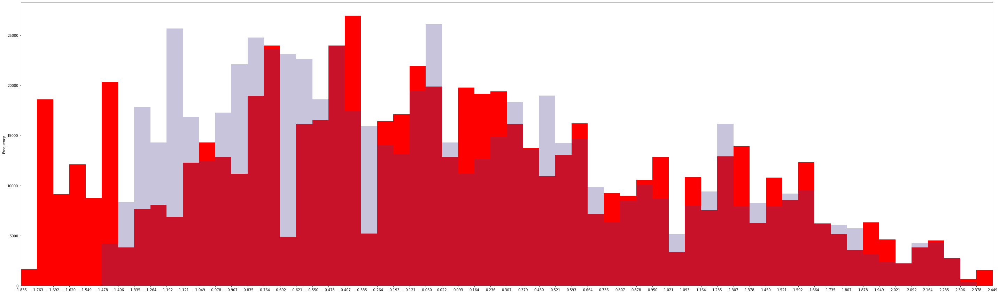

In [ ]:
# plt.hist(y_train-y_train_predict, bins = 30)
# y_train.plot(kind ='hist', 
#           figsize=(10, 6),
#           bins=15,
#           alpha=0.6,
#           xticks=bin_edges,
#           color=['coral', 'darkslateblue', 'mediumseagreen']
#          )

count, bin_edges = np.histogram(y_train, 60)

y_train.plot(kind='hist',
          figsize=(50, 15), 
          bins=60,
          xticks=bin_edges,
          color='red',
          xlim=(np.min(y_train), np.max(y_train))
         )
# plt.figure(figsize=(10,10))
# plt.hist(y_train, bins = 30, alpha = 0.6, color='red')
plt.hist(y_train_predict, bins = bin_edges, alpha = 0.3, color = 'darkslateblue')

In [ ]:
train_error = train[train['stator_yoke']<-1.40] 


In [ ]:
train_error.describe()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,profile_id,u,u_abs,u_q_d_ratio,u_phase_angle,log_u_abs,i,i_abs,i_q_d_ratio,i_phase_angle,log_i_abs,pm,stator_yoke,stator_tooth,stator_winding
count,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000+0.000000j,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000+0.000000j,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000,88587.000000
mean,-1.031562,-1.048380,0.186132,-0.302679,-0.682787,0.006268,0.807258,0.024136,24.682617,0.186132-0.302679j,0.936874,-1.424947,-0.519646,-0.182290,0.807258+0.024136j,1.111994,0.061215,-0.054605,0.076835,-1.372730,-1.578995,-1.721395,-1.692063
std,1.121850,0.094632,0.383753,0.876832,0.574270,0.623553,0.555465,0.635599,18.490327,0.957131+0.000000j,0.405733,24.687017,1.025039,0.524082,0.844113+0.000000j,0.358105,31.692370,0.483324,0.213440,0.710677,0.127851,0.172581,0.207457
min,-4.124949,-1.305783,-1.651054,-1.331502,-1.239020,-2.780820,-2.669496,-2.810363,4.000000,-1.651054-1.316630j,0.031528,-2894.460100,-1.570451,-3.456871,-2.669496+2.571008j,0.038357,-7933.768337,-1.570670,-3.260828,-2.628648,-1.834688,-2.066143,-2.019973
25%,-1.887870,-1.079175,0.170279,-1.168173,-1.189967,-0.258981,0.850143,-0.245728,10.000000,0.170279+0.410448j,0.604027,-3.922572,-1.321179,-0.504137,0.850143+0.417103j,0.987129,-0.238776,-0.234387,-0.012955,-1.865667,-1.741977,-1.843056,-1.824737
50%,-0.983473,-1.071758,0.295856,-0.563804,-0.835000,-0.186390,1.013973,-0.245699,27.000000,0.295856+1.738647j,0.957302,-2.254337,-1.153286,-0.043637,1.013973-0.091447j,1.058064,-0.238746,-0.234359,0.056441,-1.531987,-1.567202,-1.715485,-1.735600
75%,-0.063541,-1.063475,0.315606,0.406091,-0.410788,0.324855,1.029144,0.417100,30.000000,0.315606-0.709427j,1.289608,0.231128,0.227140,0.254338,1.029144-0.245726j,1.058222,0.283655,0.276394,0.056590,-1.033946,-1.448285,-1.569113,-1.591185
max,0.975084,-0.241324,2.029537,1.785646,2.024125,3.016971,1.060937,2.914185,81.000000,2.029537+0.201293j,2.120391,4464.183668,1.570572,0.751600,1.060937-0.258079j,3.706250,4514.524185,1.570575,1.310021,1.452855,-1.400007,-1.075901,-0.191434


In [ ]:
train_not_error = train[train['stator_yoke']>=-1.40] 
train_not_error.describe()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,profile_id,u,u_abs,u_q_d_ratio,u_phase_angle,log_u_abs,i,i_abs,i_q_d_ratio,i_phase_angle,log_i_abs,pm,stator_yoke,stator_tooth,stator_winding
count,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000+0.000000j,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000+0.000000j,757781.000000,7.577810e+05,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000,757781.000000
mean,0.213131,0.152885,0.036977,0.039666,0.067693,-0.047137,-0.064706,-0.048500,53.639633,0.036977+0.039666j,1.386720,-1.483115,-0.316105,0.257469,-0.064706-0.048500j,1.294631,4.102689e+01,-0.035129,0.136112,0.159983,0.198769,0.202077,0.188583
std,0.871131,1.000500,1.044324,1.006841,1.010490,1.035736,0.986763,1.035012,21.615321,1.450635+0.000000j,0.429286,995.064036,0.897658,0.423586,1.430018+0.000000j,0.612715,3.585141e+04,0.818889,0.534771,0.890702,0.904594,0.860919,0.858155
min,-8.573954,-1.429349,-1.655373,-1.861463,-1.222442,-3.345953,-3.245874,-3.341639,4.000000,-1.655373-1.214851j,0.002882,-784850.191183,-1.570795,-5.849157,-3.245874-2.389300j,0.000822,-1.870778e+05,-1.570791,-7.103359,-2.594661,-1.399995,-1.694372,-1.725685
25%,-0.148082,-0.676575,-0.885160,-0.878387,-0.897783,-0.451546,-0.833629,-0.452859,44.000000,-0.885160+1.132006j,1.272128,-3.588426,-1.299018,0.240691,-0.833629-0.020446j,0.992129,-4.744265e-01,-0.442980,-0.007902,-0.389442,-0.509017,-0.435509,-0.415313
50%,0.409525,0.055473,0.289925,-0.008656,-0.004975,-0.253861,0.044444,-0.245697,58.000000,0.289925+0.864236j,1.365759,-0.429636,-0.405790,0.311710,0.044444+1.553283j,1.058095,-2.387552e-01,-0.234368,0.056470,0.187463,0.107842,0.151717,0.145259
75%,0.688606,0.965198,0.515307,0.878076,0.941942,0.531872,0.987126,0.498373,70.000000,0.515307+1.743227j,1.704190,0.391798,0.373415,0.533090,0.987126+0.048489j,1.581818,7.872428e-01,0.666914,0.458575,0.760393,0.874678,0.859057,0.801929
max,2.967117,2.649032,2.274734,1.793498,2.024164,3.012691,1.060175,2.914179,81.000000,2.274734-1.173060j,2.912992,241462.477051,1.570792,1.069181,1.060175-0.257275j,4.030440,3.120639e+07,1.570796,1.393876,2.917456,2.449158,2.302169,2.653781


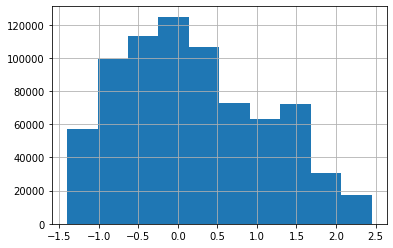

In [ ]:
train_not_error['stator_yoke'].hist()

In [ ]:
!pip install category_encoders

     |████████████████████████████████| 81kB 2.1MB/s 


In [ ]:
from category_encoders.target_encoder import TargetEncoder

X = train[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque','profile_id']]
y = train['stator_yoke']

target_encoder=TargetEncoder(cols='profile_id', smoothing = 0.0)

In [ ]:
X_test

,coolant,ambient,u_abs,u_phase_angle,motor_speed,torque,profile_id
0,-1.073478,-2.749564,1.338842,-1.316764,-1.222426,-0.248547,0
1,-1.072823,-2.749612,1.341814,-1.315374,-1.222425,-0.247740,0
2,-1.073277,-2.746339,1.343109,-1.314271,-1.222428,-0.247232,0
3,-1.074854,-2.747337,1.344523,-1.313626,-1.222428,-0.246810,0
4,-1.076696,-2.748052,1.346500,-1.312419,-1.222429,-0.246473,0
...,...,...,...,...,...,...,...
76418,1.633554,0.688609,1.314730,-1.332661,0.273299,1.010686,0
76419,1.633553,0.688609,1.314730,-1.332661,0.265776,1.047163,0
76420,1.633745,0.688609,0.974379,-1.344431,0.258588,1.088225,0
76421,1.633884,0.688609,0.840459,1.229138,0.327896,1.130760,0


In [ ]:
for train_index, test_index in skf.split(X, y_binned):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    target_encoder.fit_transform(X_train, y_train)
    target_encoder.transform(X_valid, y_valid)
    # X_train = np.array(X_train).reshape(-1,1)
    # X_valid = np.array(X_valid).reshape(-1,1)
    reg.fit(X_train, y_train)
    coeff_list = list(X.columns)
    coeff_list.insert(0,'Intercept')
    coeff_values = np.append(reg.intercept_,reg.coef_)
    coeff_df = pd.DataFrame(coeff_values, coeff_list, columns=['Coefficient'])
    print( coeff_df)
    y_train_predict = reg.predict(X_train)
    y_valid_predict = reg.predict(X_valid)
    X_test['profile_id'] = 0
    y_test_predict = reg.predict(X_test)
    print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)} \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)} \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)}')

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


               Coefficient
Intercept        -0.103572
coolant           0.875117
ambient           0.140493
u_abs             0.019041
u_phase_angle     0.065195
motor_speed       0.110669
torque            0.033465
profile_id        0.000378
 RMSE training set: 0.37138705102974684 
 RMSE validation set: 0.6097234683655559 
 RMSE test set: 0.6220883567883445


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


               Coefficient
Intercept        -0.141702
coolant           0.867186
ambient           0.082480
u_abs             0.158741
u_phase_angle     0.055068
motor_speed       0.144032
torque            0.096025
profile_id       -0.001393
 RMSE training set: 0.4188354659748199 
 RMSE validation set: 0.39187516191611055 
 RMSE test set: 0.4542696400932192


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


               Coefficient
Intercept        -0.180635
coolant           0.871150
ambient           0.082993
u_abs             0.201183
u_phase_angle     0.066627
motor_speed       0.122262
torque            0.109650
profile_id       -0.001522
 RMSE training set: 0.4174633515769852 
 RMSE validation set: 0.3982879788291926 
 RMSE test set: 0.44393095346604095


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


               Coefficient
Intercept        -0.204026
coolant           0.854873
ambient           0.077669
u_abs             0.191606
u_phase_angle     0.062278
motor_speed       0.119386
torque            0.108136
profile_id       -0.000435
 RMSE training set: 0.4223763601511555 
 RMSE validation set: 0.37934707944115653 
 RMSE test set: 0.45110082088494236


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


               Coefficient
Intercept        -0.237233
coolant           0.840260
ambient           0.081878
u_abs             0.157163
u_phase_angle     0.058057
motor_speed       0.136472
torque            0.106571
profile_id        0.001403
 RMSE training set: 0.4137978768215068 
 RMSE validation set: 0.42807776211769394 
 RMSE test set: 0.4804913470679199


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


In [ ]:

X = train[['coolant', 'ambient', 'u_abs','u_phase_angle','motor_speed','torque']]
y = train['stator_yoke']
y_test = test['stator_yoke']
for train_index, test_index in skf.split(X, y_binned):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    X_test=test[X.columns]
    # X_train = np.array(X_train).reshape(-1,1)
    # X_valid = np.array(X_valid).reshape(-1,1)
    reg.fit(X_train, y_train)
    # coeff_list = list(X.columns)
    # coeff_list.insert(0,'Intercept')
    # coeff_values = np.append(reg.intercept_,reg.coef_)
    # coeff_df = pd.DataFrame(coeff_values, coeff_list, columns=['Coefficient'])
    # print( coeff_df)
    y_train_predict = reg.predict(X_train)
    y_valid_predict = reg.predict(X_valid)
    y_test_predict = reg.predict(X_test)
    print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)} \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)} \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)}')

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


 RMSE training set: 0.3714231628856854 
 RMSE validation set: 0.6066755532342379 
 RMSE test set: 0.611854010691963
 RMSE training set: 0.4197076218650637 
 RMSE validation set: 0.38968709056389994 
 RMSE test set: 0.4721342007427099
 RMSE training set: 0.4185415085514284 
 RMSE validation set: 0.39453892166952476 
 RMSE test set: 0.46092957600497086
 RMSE training set: 0.4224593086961803 
 RMSE validation set: 0.3804341852737078 
 RMSE test set: 0.45614329592732317
 RMSE training set: 0.4144414228925043 
 RMSE validation set: 0.41404010904122407 
 RMSE test set: 0.4623276170544594


In [ ]:
import xgboost

model = xgboost.XGBRegressor(colsample_bytree=0.4,
                 gamma=0,                 
                 learning_rate=0.07,
                 max_depth=3,
                 min_child_weight=1.5,
                 n_estimators=10000,                                                                    
                 reg_alpha=0.75,
                 reg_lambda=0.45,
                 subsample=0.6,
                 seed=42) 

In [ ]:
for train_index, test_index in skf.split(X, y_binned):
    X_train, X_valid = X.iloc[train_index], X.iloc[test_index]
    y_train, y_valid = y.iloc[train_index], y.iloc[test_index]
    # X_train = np.array(X_train).reshape(-1,1)
    # X_valid = np.array(X_valid).reshape(-1,1)
    model.fit(X_train, y_train)
    # coeff_list = list(X.columns)
    # coeff_list.insert(0,'Intercept')
    # coeff_values = np.append(reg.intercept_,reg.coef_)
    # coeff_df = pd.DataFrame(coeff_values, coeff_list, columns=['Coefficient'])
    # print( coeff_df)
    y_train_predict = model.predict(X_train)
    y_valid_predict = model.predict(X_valid)
    y_test_predict = model.predict(X_test)
    print(f' RMSE training set: {rmse(y_train_predict, y_train, squared = False)} \n RMSE validation set: {rmse(y_valid_predict, y_valid, squared = False)} \n RMSE test set: {rmse(y_test_predict, y_test, squared = False)}')

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


[21:38:43] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
 RMSE training set: 0.2129349488464767 
 RMSE validation set: 0.5569869294027517 
 RMSE test set: 0.567245856450276
[22:28:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
 RMSE training set: 0.2071086888936652 
 RMSE validation set: 0.38842156550543555 
 RMSE test set: 0.43364658809492546
[23:19:35] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
 RMSE training set: 0.19559380658839157 
 RMSE validation set: 0.41723390848491665 
 RMSE test set: 0.4487562865192992
[00:10:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
 RMSE training set: 0.19500461020697402 
 RMSE validation set: 0.4005857494421269 
 RMSE test set: 0.4386712428865995
[01:00:56] WARNING: 

In [ ]:

# For stratified Kfold, split the y into bins
bins = np.linspace(np.min(y), np.max(y), 10) 
y_binned = np.digitize(y, bins)

train_and_predict()

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


 RMSE training set: 0.4005087790306216 
 RMSE validation set: 0.7125776627331409 
 RMSE test set: 
 intercept: -0.10305531417993831
 Coefficient: [0.86805637 0.17097536]
 RMSE training set: 0.4819855183988718 
 RMSE validation set: 0.40522028016029565 
 RMSE test set: 
 intercept: -0.03291893472667868
 Coefficient: [0.82353119 0.10283436]
 RMSE training set: 0.4823374135023549 
 RMSE validation set: 0.4027575785680053 
 RMSE test set: 
 intercept: -0.012739339917747686
 Coefficient: [0.83578787 0.09314065]
 RMSE training set: 0.4783166157940644 
 RMSE validation set: 0.4275035763497182 
 RMSE test set: 
 intercept: 0.015316458045172916
 Coefficient: [0.82997058 0.09757515]
 RMSE training set: 0.4700422156285265 
 RMSE validation set: 0.4659723693691015 
 RMSE test set: 
 intercept: 0.025615949577501514
 Coefficient: [0.82571033 0.11493089]


In [ ]:
X = train[['coolant', 'ambient','u_abs','i_abs']]
y = train['stator_yoke']

# For stratified Kfold, split the y into bins
bins = np.linspace(np.min(y), np.max(y), 10) 
y_binned = np.digitize(y, bins)


In [ ]:
X

,coolant,ambient,u_abs,i_abs
0,-1.118446,-0.752143,1.338647,1.338647
1,-1.117021,-0.771263,1.338906,1.338906
2,-1.116681,-0.782892,1.343680,1.343680
3,-1.116764,-0.780935,1.343940,1.343940
4,-1.116775,-0.774043,1.345541,1.345541
...,...,...,...,...
846363,0.341638,-0.047497,1.289448,1.289448
846364,0.320022,-0.048839,1.293895,1.293895
846365,0.307415,-0.042350,1.290025,1.290025
846366,0.302082,-0.039433,1.292600,1.292600


In [ ]:
train_and_predict()

/usr/local/lib/python3.6/dist-packages/sklearn/model_selection/_split.py:667: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


 RMSE training set: 0.4005087790306216 
 RMSE validation set: 0.7125776627331409 
 RMSE test set: 
 intercept: -0.10305531417993831
 Coefficient: [0.86805637 0.17097536]
 RMSE training set: 0.4819855183988718 
 RMSE validation set: 0.40522028016029565 
 RMSE test set: 
 intercept: -0.03291893472667868
 Coefficient: [0.82353119 0.10283436]
 RMSE training set: 0.4823374135023549 
 RMSE validation set: 0.4027575785680053 
 RMSE test set: 
 intercept: -0.012739339917747686
 Coefficient: [0.83578787 0.09314065]
 RMSE training set: 0.4783166157940644 
 RMSE validation set: 0.4275035763497182 
 RMSE test set: 
 intercept: 0.015316458045172916
 Coefficient: [0.82997058 0.09757515]
 RMSE training set: 0.4700422156285265 
 RMSE validation set: 0.4659723693691015 
 RMSE test set: 
 intercept: 0.025615949577501514
 Coefficient: [0.82571033 0.11493089]


#Leftovers

In [ ]:
# List columns names for interaction variables
columns_for_interaction = ['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed',
 'torque', 'i_d', 'i_q', 'u', 'u_abs', 'log_u_abs', 'i', 'i_abs', 'log_i_abs',]

# Get one hot encoding of columns 'vehicleType'
one_hot = pd.get_dummies(train['profile_id'], prefix='profile_id', prefix_sep='_')
profile_id_for_interaction = list(one_hot.columns)

# Drop column as it is now encoded
train = train.drop('profile_id',axis = 1)

# Join the encoded df
train = train.join(one_hot)

In [ ]:
train.columns

Index(['ambient', 'coolant', 'u_d', 'u_q', 'motor_speed', 'torque', 'i_d',
       'i_q', 'pm', 'stator_yoke', 'stator_tooth', 'stator_winding', 'u',
       'u_abs', 'log_u_abs', 'i', 'i_abs', 'log_i_abs', 'profile_id_4',
       'profile_id_6', 'profile_id_10', 'profile_id_11', 'profile_id_20',
       'profile_id_27', 'profile_id_29', 'profile_id_30', 'profile_id_36',
       'profile_id_43', 'profile_id_44', 'profile_id_45', 'profile_id_46',
       'profile_id_47', 'profile_id_48', 'profile_id_49', 'profile_id_50',
       'profile_id_53', 'profile_id_54', 'profile_id_55', 'profile_id_56',
       'profile_id_57', 'profile_id_58', 'profile_id_59', 'profile_id_60',
       'profile_id_63', 'profile_id_64', 'profile_id_65', 'profile_id_66',
       'profile_id_67', 'profile_id_68', 'profile_id_69', 'profile_id_70',
       'profile_id_72', 'profile_id_74', 'profile_id_75', 'profile_id_76',
       'profile_id_77', 'profile_id_78', 'profile_id_79', 'profile_id_80',
       'profile_id_81'],
     

In [ ]:
print(len(columns_for_interaction), len(profile_id_for_interaction))

14 42


In [ ]:
# Create interaction variables with the profile_id
def interaction_variables(df):
  for column_for_interaction in columns_for_interaction:
    for profile_id in profile_id_for_interaction:
    
      name = profile_id + "_" + column_for_interaction
      # df[name] = pd.Series(df[profile_id] * df[column_for_interaction], name=name)
      df[name] = df[profile_id] * df[column_for_interaction]
    
      # df[profile_id+'_'+column_for_interaction] = df[profile_id]*df[column_for_interaction]
      # print(profile_id+'_'+column_for_interaction)



In [ ]:
interaction_variables(train)
train.columns


In [ ]:
train.head()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_yoke,stator_tooth,stator_winding,u,u_abs,log_u_abs,i,i_abs,log_i_abs,profile_id_4,profile_id_6,profile_id_10,profile_id_11,profile_id_20,profile_id_27,profile_id_29,profile_id_30,profile_id_36,profile_id_43,profile_id_44,profile_id_45,profile_id_46,profile_id_47,profile_id_48,profile_id_49,profile_id_50,profile_id_53,profile_id_54,profile_id_55,profile_id_56,profile_id_57,...,profile_id_10_ambient,profile_id_11_ambient,profile_id_20_ambient,profile_id_27_ambient,profile_id_29_ambient,profile_id_30_ambient,profile_id_36_ambient,profile_id_43_ambient,profile_id_44_ambient,profile_id_45_ambient,profile_id_46_ambient,profile_id_47_ambient,profile_id_48_ambient,profile_id_49_ambient,profile_id_50_ambient,profile_id_53_ambient,profile_id_54_ambient,profile_id_55_ambient,profile_id_56_ambient,profile_id_57_ambient,profile_id_58_ambient,profile_id_59_ambient,profile_id_60_ambient,profile_id_63_ambient,profile_id_64_ambient,profile_id_65_ambient,profile_id_66_ambient,profile_id_67_ambient,profile_id_68_ambient,profile_id_69_ambient,profile_id_70_ambient,profile_id_72_ambient,profile_id_74_ambient,profile_id_75_ambient,profile_id_76_ambient,profile_id_77_ambient,profile_id_78_ambient,profile_id_79_ambient,profile_id_80_ambient,profile_id_81_ambient
0,-0.752143,-1.118446,0.327935,-1.297858,-1.222428,-0.250182,1.029572,-0.245860,-2.522071,-1.831422,-2.066143,-2.018033,0.327935-1.297858j,1.338647,0.291659,1.029572-0.245860j,1.058521,0.056873,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
1,-0.771263,-1.117021,0.329665,-1.297686,-1.222429,-0.249133,1.029509,-0.245832,-2.522418,-1.830969,-2.064859,-2.017631,0.329665-1.297686j,1.338906,0.291853,1.029509-0.245832j,1.058453,0.056808,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
2,-0.782892,-1.116681,0.332771,-1.301822,-1.222428,-0.249431,1.029448,-0.245818,-2.522673,-1.830400,-2.064073,-2.017343,0.332771-1.301822j,1.343680,0.295412,1.029448-0.245818j,1.058390,0.056749,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
3,-0.780935,-1.116764,0.333700,-1.301852,-1.222430,-0.248636,1.032845,-0.246955,-2.521639,-1.830333,-2.063137,-2.017632,0.333700-1.301852j,1.343940,0.295605,1.032845-0.246955j,1.061958,0.060115,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0
4,-0.774043,-1.116775,0.335206,-1.303118,-1.222429,-0.248701,1.031807,-0.246610,-2.521900,-1.830498,-2.062795,-2.018145,0.335206-1.303118j,1.345541,0.296796,1.031807-0.246610j,1.060869,0.059088,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0


In [ ]:
train = train[[c for c in train if c not in ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']] 
       + ['pm', 'stator_yoke', 'stator_tooth', 'stator_winding']]

In [ ]:
train.describe(percentiles=[0.05, 0.1, 0.25, 0.5, .75, 0.9, 0.95])

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,u,u_abs,log_u_abs,i,i_abs,log_i_abs,profile_id_4,profile_id_6,profile_id_10,profile_id_11,profile_id_20,profile_id_27,profile_id_29,profile_id_30,profile_id_36,profile_id_43,profile_id_44,profile_id_45,profile_id_46,profile_id_47,profile_id_48,profile_id_49,profile_id_50,profile_id_53,profile_id_54,profile_id_55,profile_id_56,profile_id_57,profile_id_58,profile_id_59,profile_id_60,profile_id_63,profile_id_64,profile_id_65,profile_id_66,profile_id_67,profile_id_68,profile_id_69,profile_id_70,profile_id_72,profile_id_74,profile_id_75,profile_id_76,profile_id_77,profile_id_78,profile_id_79,profile_id_80,profile_id_81,pm,stator_yoke,stator_tooth,stator_winding
count,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000+0.000000j,846368.000000,846368.000000,846368.000000+0.000000j,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.00000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000,846368.000000
mean,0.082853,0.027152,0.052589,0.003834,-0.010858,-0.041547,0.026560,-0.040897,0.052589+0.003834j,1.339636,0.211441,0.026560-0.040897j,1.275515,0.129908,0.039490,0.047718,0.018024,0.009317,0.051951,0.041779,0.025234,0.028193,0.026712,0.009974,0.031121,0.020252,0.002575,0.002570,0.025972,0.012778,0.012771,0.038330,0.012767,0.012767,0.039134,0.017016,0.03944,0.008831,0.017182,0.019692,0.007383,0.047371,0.043096,0.013155,0.027565,0.018135,0.030337,0.018077,0.028073,0.015916,0.026214,0.017275,0.009977,0.036808,0.028147,0.020879,-0.000441,0.012695,0.000753,-0.008259
std,0.977933,1.016069,0.996975,0.999539,1.000756,1.000715,0.987589,1.000951,1.411750+0.000000j,0.448544,0.455539,1.406142+0.000000j,0.593864,0.511023,0.194758,0.213169,0.133038,0.096076,0.221929,0.200083,0.156834,0.165525,0.161240,0.099373,0.173645,0.140863,0.050675,0.050628,0.159052,0.112316,0.112285,0.191991,0.112270,0.112270,0.193914,0.129332,0.19464,0.093556,0.129948,0.138941,0.085608,0.212431,0.203073,0.113939,0.163722,0.133440,0.171512,0.133231,0.165181,0.125152,0.159772,0.130294,0.099384,0.188290,0.165394,0.142978,0.991628,1.015148,1.006694,0.997647
min,-8.573954,-1.429349,-1.655373,-1.861463,-1.239020,-3.345953,-3.245874,-3.341639,-1.655373-1.214851j,0.002882,-5.849157,-3.245874-2.389300j,0.000822,-7.103359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-2.628648,-1.834688,-2.066143,-2.019973
5%,-1.928271,-1.083429,-1.580818,-1.316379,-1.222431,-1.855620,-1.895122,-1.827674,-1.580818-0.582498j,0.446323,-0.806713,-1.895122+0.368193j,0.438303,-0.824845,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.819922,-1.573486,-1.734224,-1.744125
10%,-1.130680,-1.074681,-1.365719,-1.297149,-1.222430,-1.360123,-1.426571,-1.368011,-1.365719+0.267728j,0.637452,-0.450277,-1.426

In [ ]:
sns.pairplot(train)

In [ ]:

profile_id = 'profile_id_4'
df_corr = train[train[profile_id]==1]
df_corr.drop(list(one_hot), axis=1, inplace = True)
df_corr.head()


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7466: ComplexWarning: Casting complex values to real discards the imaginary part
  correl = libalgos.nancorr(ensure_float64(mat), minp=min_periods)
/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,u,u_abs,log_u_abs,i,i_abs,log_i_abs,pm,stator_yoke,stator_tooth,stator_winding
0,-0.752143,-1.118446,0.327935,-1.297858,-1.222428,-0.250182,1.029572,-0.245860,0.327935-1.297858j,1.338647,0.291659,1.029572-0.245860j,1.058521,0.056873,-2.522071,-1.831422,-2.066143,-2.018033
1,-0.771263,-1.117021,0.329665,-1.297686,-1.222429,-0.249133,1.029509,-0.245832,0.329665-1.297686j,1.338906,0.291853,1.029509-0.245832j,1.058453,0.056808,-2.522418,-1.830969,-2.064859,-2.017631
2,-0.782892,-1.116681,0.332771,-1.301822,-1.222428,-0.249431,1.029448,-0.245818,0.332771-1.301822j,1.343680,0.295412,1.029448-0.245818j,1.058390,0.056749,-2.522673,-1.830400,-2.064073,-2.017343
3,-0.780935,-1.116764,0.333700,-1.301852,-1.222430,-0.248636,1.032845,-0.246955,0.333700-1.301852j,1.343940,0.295605,1.032845-0.246955j,1.061958,0.060115,-2.521639,-1.830333,-2.063137,-2.017632
4,-0.774043,-1.116775,0.335206,-1.303118,-1.222429,-0.248701,1.031807,-0.246610,0.335206-1.303118j,1.345541,0.296796,1.031807-0.246610j,1.060869,0.059088,-2.521900,-1.830498,-2.062795,-2.018145


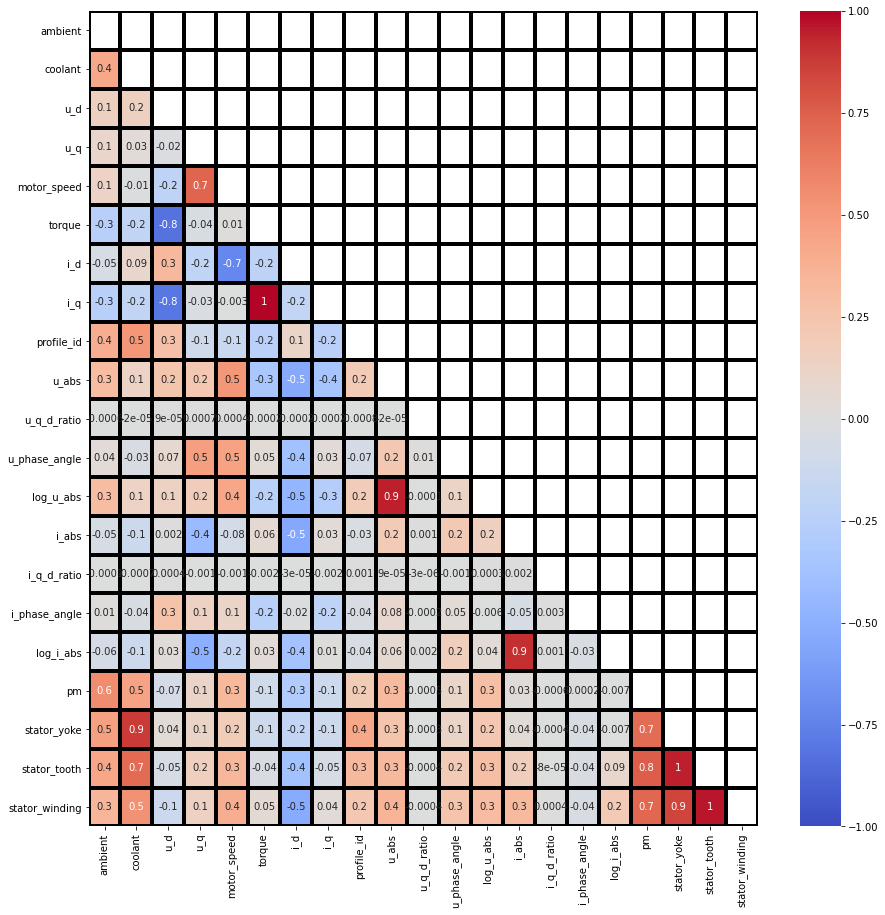

/usr/local/lib/python3.6/dist-packages/pandas/core/dtypes/cast.py:897: ComplexWarning: Casting complex values to real discards the imaginary part
  return arr.astype(dtype, copy=True)
/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:854: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/usr/local/lib/python3.6/dist-packages/matplotlib/transforms.py:789: ComplexWarning: Casting complex values to real discards the imaginary part
  points = np.array(args, dtype=float).reshape(2, 2)
/usr/local/lib/python3.6/dist-packages/matplotlib/transforms.py:1969: ComplexWarning: Casting complex values to real discards the imaginary part
  x, y = float(x), float(y)
/usr/local/lib/python3.6/dist-packages/numpy/core/_asarray.py:138: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order, subok=True)


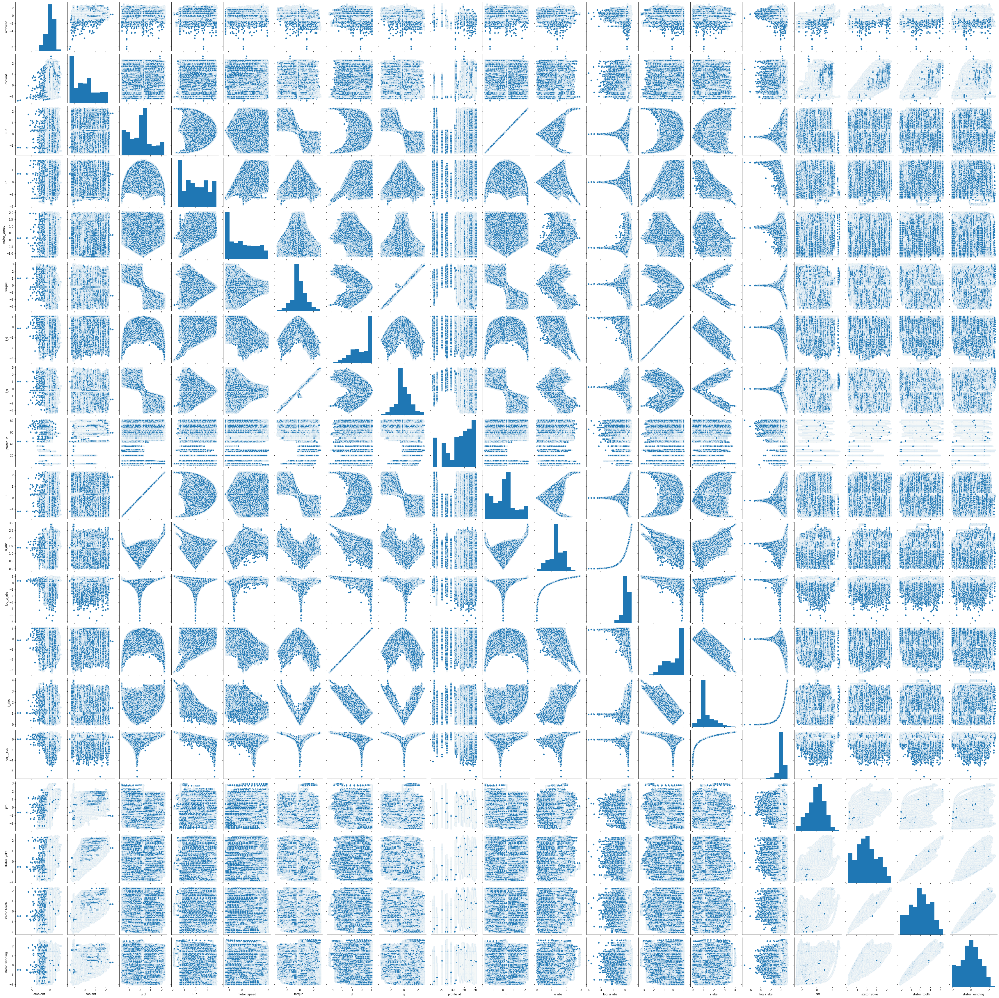

In [ ]:
profile = ProfileReport(train)

/usr/local/lib/python3.6/dist-packages/numpy/lib/histograms.py:854: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/usr/local/lib/python3.6/dist-packages/matplotlib/transforms.py:789: ComplexWarning: Casting complex values to real discards the imaginary part
  points = np.array(args, dtype=float).reshape(2, 2)
/usr/local/lib/python3.6/dist-packages/matplotlib/transforms.py:1969: ComplexWarning: Casting complex values to real discards the imaginary part
  x, y = float(x), float(y)


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f9aa0a31828>,
      dtype=object)

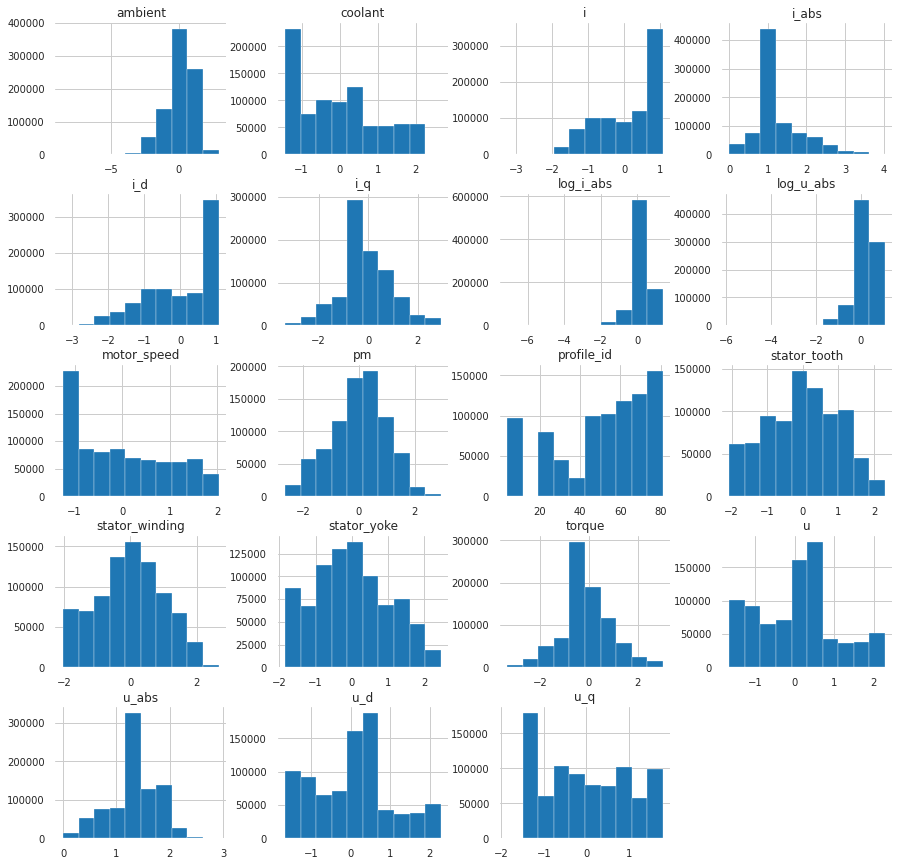

In [ ]:
train.hist(bins=10,figsize = (15,15))

#Model

##lodaing and preparing test set

In [ ]:
test = pd.read_csv('/content/drive/My Drive/ODSC/test_set.csv')
test_solutions = pd.read_csv('/content/drive/My Drive/ODSC/test_solutions.csv')
test = pd.merge(test, test_solutions, left_index=True, right_index=True)
test.head()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_tooth,stator_yoke,stator_winding
0,-2.749564,-1.073478,0.336463,-1.295874,-1.222426,-0.248547,1.041590,-0.250223,-2.450515,-2.046755,-1.800853,-1.993896
1,-2.749612,-1.072823,0.339015,-1.298281,-1.222425,-0.247740,1.038055,-0.248936,-2.450277,-2.047172,-1.801808,-1.994415
2,-2.746339,-1.073277,0.340775,-1.299160,-1.222428,-0.247232,1.035532,-0.248042,-2.450026,-2.047384,-1.802578,-1.995002
3,-2.747337,-1.074854,0.341972,-1.300307,-1.222428,-0.246810,1.033727,-0.247364,-2.449813,-2.047343,-1.801862,-1.995174
4,-2.748052,-1.076696,0.344047,-1.301804,-1.222429,-0.246473,1.032427,-0.246897,-2.450108,-2.047665,-1.801228,-1.995189


In [ ]:
test['u']=test['u_d'] + test['u_q'] * 1j
test['u_abs']=np.abs(test['u'])
test['i']=test['i_d'] + test['i_q'] * 1j
test['i_abs']=np.abs(test['i'])
test.head()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_tooth,stator_yoke,stator_winding,u,u_abs,i,i_abs
0,-2.749564,-1.073478,0.336463,-1.295874,-1.222426,-0.248547,1.041590,-0.250223,-2.450515,-2.046755,-1.800853,-1.993896,0.336463-1.295874j,1.338842,1.041590-0.250223j,1.071224
1,-2.749612,-1.072823,0.339015,-1.298281,-1.222425,-0.247740,1.038055,-0.248936,-2.450277,-2.047172,-1.801808,-1.994415,0.339015-1.298281j,1.341814,1.038055-0.248936j,1.067486
2,-2.746339,-1.073277,0.340775,-1.299160,-1.222428,-0.247232,1.035532,-0.248042,-2.450026,-2.047384,-1.802578,-1.995002,0.340775-1.299160j,1.343109,1.035532-0.248042j,1.064825
3,-2.747337,-1.074854,0.341972,-1.300307,-1.222428,-0.246810,1.033727,-0.247364,-2.449813,-2.047343,-1.801862,-1.995174,0.341972-1.300307j,1.344523,1.033727-0.247364j,1.062912
4,-2.748052,-1.076696,0.344047,-1.301804,-1.222429,-0.246473,1.032427,-0.246897,-2.450108,-2.047665,-1.801228,-1.995189,0.344047-1.301804j,1.346500,1.032427-0.246897j,1.061538


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:7466: ComplexWarning: Casting complex values to real discards the imaginary part
  correl = libalgos.nancorr(ensure_float64(mat), minp=min_periods)


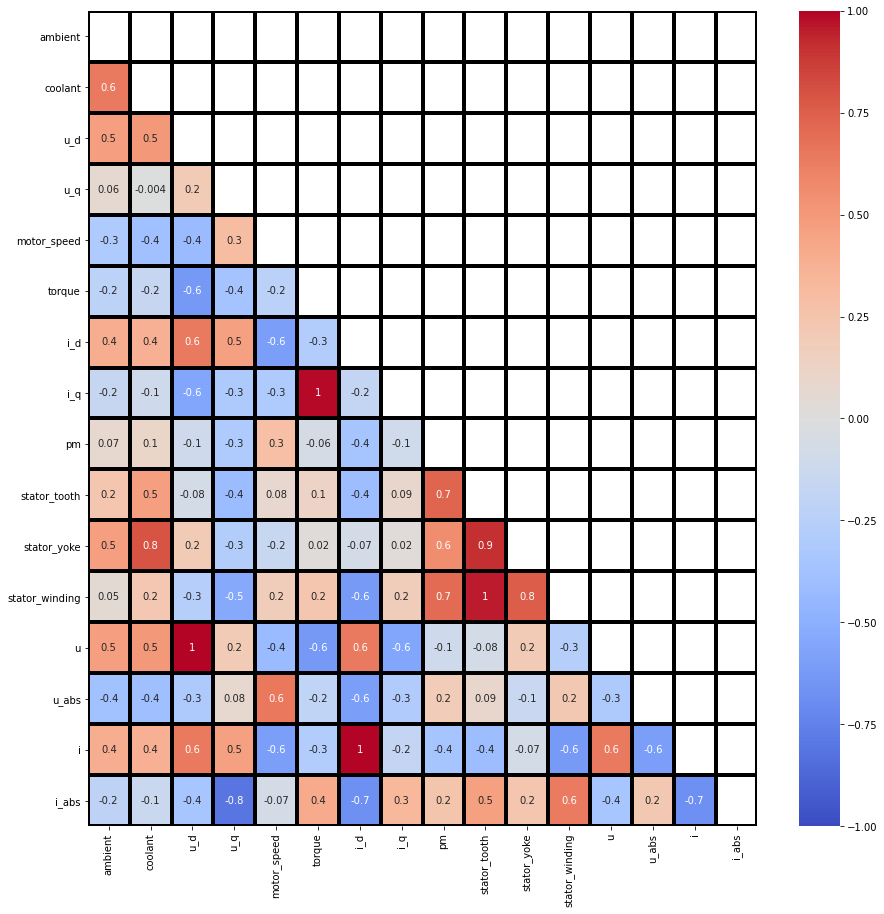

In [ ]:
fig, ax = plt.subplots(figsize=(15,15))
matrix = np.triu(test.corr())

sns.heatmap(test.corr(), annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black', mask=matrix,  ax=ax)


Text(0, 0.5, 'stator_tooth')

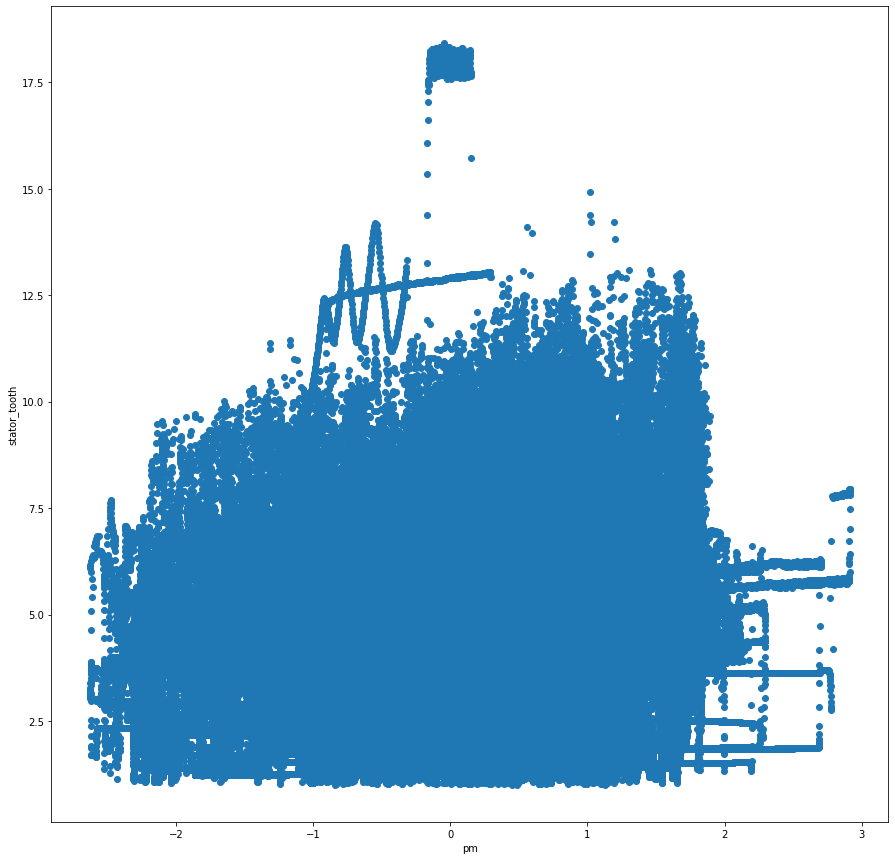

In [ ]:
plt.figure(figsize=(15, 15))
plt.scatter(train['pm'],np.exp(train['u_abs']))
plt.xlabel('pm')
plt.ylabel('stator_tooth')

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

x = train[['ambient', 'coolant', 'u_abs', 'motor_speed', 'torque', 'i_abs']]


In [ ]:
x = scaler.fit_transform(x)

In [ ]:
x

array([[-0.85383789, -1.12748105, -0.0022049 , -1.21065574, -0.20848602,
        -0.36539328],
       [-0.87338962, -1.12607809, -0.00162742, -1.21065684, -0.20743797,
        -0.36550796],
       [-0.88528041, -1.12574416,  0.00901659, -1.21065534, -0.20773553,
        -0.36561398],
       ...,
       [-0.12802817,  0.27583127, -0.11060432, -1.21065714, -0.21393975,
        -0.36608046],
       [-0.12504547,  0.27058224, -0.10486382, -1.21065954, -0.21393975,
        -0.36614215],
       [-0.12951336,  0.28099915, -0.11123402, -1.21065884, -0.21393975,
        -0.36615406]])

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['pc_1', 'pc_2', 'pc_3'])
finalDf = pd.concat([principalDf, train[['pm']]], axis = 1)
sum(pca.explained_variance_ratio_)
pca.components_
y=finalDf['pm']
from sklearn.linear_model import LinearRegression, LogisticRegression
X = finalDf[['pc_1', 'pc_2', 'pc_3']]
y = finalDf['pm']
# model = LinearRegression()
model = LogisticRegression()
clf = model.fit(X, y)
y_predicted = clf.predict(X)
clf.score


In [ ]:
finalDf = pd.concat([principalDf, train[['pm']]], axis = 1)

In [ ]:
finalDf.columns

Index(['pc_1', 'pc_2', 'pc_3', 'pm'], dtype='object')

Text(0, 0.5, 'stator_tooth')

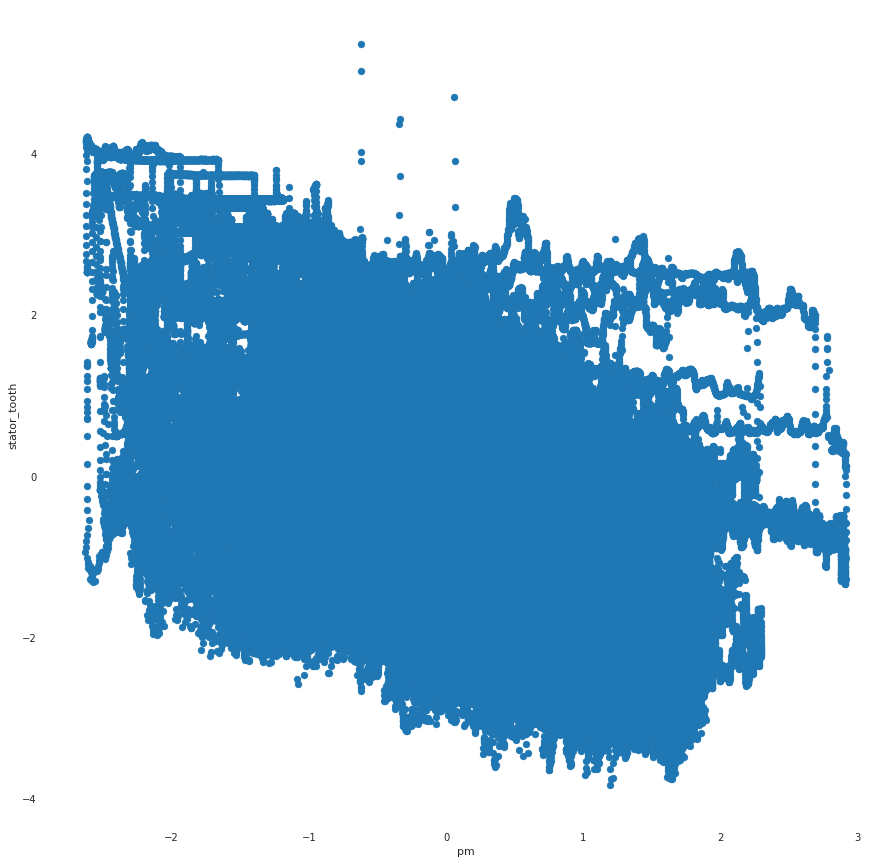

In [ ]:
plt.figure(figsize=(15, 15))
plt.scatter(finalDf['pm'],finalDf['pc_1'])
plt.xlabel('pm')
plt.ylabel('stator_tooth')

In [ ]:
sum(pca.explained_variance_ratio_)

0.7156132859270967

In [ ]:

pca.components_

array([[-0.507473  , -0.38281965, -0.5517471 , -0.3584486 ,  0.40343935,
         0.01570713],
       [-0.28462429, -0.50424774,  0.42732004,  0.51014121,  0.18428542,
         0.43349237],
       [ 0.06918663,  0.05003191,  0.06948025, -0.53831522, -0.2794158 ,
         0.78741733]])

In [ ]:
y=finalDf['pm']
y

0        -2.522071
1        -2.522418
2        -2.522673
3        -2.521639
4        -2.521900
            ...   
846363    0.429853
846364    0.429751
846365    0.429439
846366    0.429558
846367    0.429166
Name: pm, Length: 846368, dtype: float64

In [ ]:
from sklearn.linear_model import LinearRegression, LogisticRegression
X = finalDf[['pc_1', 'pc_2', 'pc_3']]
y = finalDf['pm']
# model = LinearRegression()
model = LogisticRegression()
clf = model.fit(X, y)
y_predicted = clf.predict(X)
clf.score

ValueError: ignored

In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt

rmse = sqrt(mean_squared_error(y, y_predicted))
rmse

0.7413688880720339

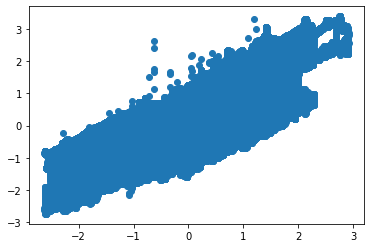

In [ ]:
plt.scatter(y, y-y_predicted)

In [ ]:
sum(y-y_predicted)

NameError: ignored